<a href="https://colab.research.google.com/github/michp15/DSC514_NLP_Project/blob/main/NUTRITION_%26_CALORIES_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd

file_path = "full_dataset.csv"  # Adjust if needed

# Load only the first 1000 rows
df = pd.read_csv(file_path, nrows=1000)

# Display sample data
df.head(10)


,Unnamed: 0,title,ingredients,directions,link,source,NER
0,0,No-Bake Nut Cookies,"[""1 c. firmly packed brown sugar"", ""1/2 c. eva...","[""In a heavy 2-quart saucepan, mix brown sugar...",www.cookbooks.com/Recipe-Details.aspx?id=44874,Gathered,"[""brown sugar"", ""milk"", ""vanilla"", ""nuts"", ""bu..."
1,1,Jewell Ball'S Chicken,"[""1 small jar chipped beef, cut up"", ""4 boned ...","[""Place chipped beef on bottom of baking dish....",www.cookbooks.com/Recipe-Details.aspx?id=699419,Gathered,"[""beef"", ""chicken breasts"", ""cream of mushroom..."
2,2,Creamy Corn,"[""2 (16 oz.) pkg. frozen corn"", ""1 (8 oz.) pkg...","[""In a slow cooker, combine all ingredients. C...",www.cookbooks.com/Recipe-Details.aspx?id=10570,Gathered,"[""frozen corn"", ""cream cheese"", ""butter"", ""gar..."
3,3,Chicken Funny,"[""1 large whole chicken"", ""2 (10 1/2 oz.) cans...","[""Boil and debone chicken."", ""Put bite size pi...",www.cookbooks.com/Recipe-Details.aspx?id=897570,Gathered,"[""chicken"", ""chicken gravy"", ""cream of mushroo..."
4,4,Reeses Cups(Candy),"[""1 c. peanut butter"", ""3/4 c. graham cracker ...","[""Combine first four ingredients and press in ...",www.cookbooks.com/Recipe-Details.aspx?id=659239,Gathered,"[""peanut butter"", ""graham cracker crumbs"", ""bu..."
5,5,Cheeseburger Potato Soup,"[""6 baking potatoes"", ""1 lb. of extra lean gro...","[""Wash potatoes; prick several times with a fo...",www.cookbooks.com/Recipe-Details.aspx?id=20115,Gathered,"[""baking potatoes"", ""extra lean ground beef"", ..."
6,6,Rhubarb Coffee Cake,"[""1 1/2 c. sugar"", ""1/2 c. butter"", ""1 egg"", ""...","[""Cream sugar and butter."", ""Add egg and beat ...",www.cookbooks.com/Recipe-Details.aspx?id=210288,Gathered,"[""sugar"", ""butter"", ""egg"", ""buttermilk"", ""flou..."
7,7,Scalloped Corn,"[""1 can cream-style corn"", ""1 can whole kernel...","[""Mix together both cans of corn, crackers, eg...",www.cookbooks.com/Recipe-Details.aspx?id=876969,Gathered,"[""cream-style corn"", ""whole kernel corn"", ""cra..."
8,8,Nolan'S Pepper Steak,"[""1 1/2 lb. round steak (1-inch thick), cut in...","[""Roll steak strips in flour."", ""Brown in skil...",www.cookbooks.com/Recipe-Details.aspx?id=375254,Gathered,"[""tomatoes"", ""water"", ""onions"", ""Worcestershir..."
9,9,Millionaire Pie,"[""1 large container Cool Whip"", ""1 large can c...","[""Empty Cool Whip into a bowl."", ""Drain juice ...",www.cookbooks.com/Recipe-Details.aspx?id=794547,Gathered,"[""pineapple"", ""condensed milk"", ""lemons"", ""pec..."


In [ ]:
import re
import ast

# Drop unnecessary columns, keeping only 'ingredients' and 'NER'
df_new = df[['ingredients','directions', 'NER']]

df_new

,ingredients,directions,NER
0,"[""1 c. firmly packed brown sugar"", ""1/2 c. eva...","[""In a heavy 2-quart saucepan, mix brown sugar...","[""brown sugar"", ""milk"", ""vanilla"", ""nuts"", ""bu..."
1,"[""1 small jar chipped beef, cut up"", ""4 boned ...","[""Place chipped beef on bottom of baking dish....","[""beef"", ""chicken breasts"", ""cream of mushroom..."
2,"[""2 (16 oz.) pkg. frozen corn"", ""1 (8 oz.) pkg...","[""In a slow cooker, combine all ingredients. C...","[""frozen corn"", ""cream cheese"", ""butter"", ""gar..."
3,"[""1 large whole chicken"", ""2 (10 1/2 oz.) cans...","[""Boil and debone chicken."", ""Put bite size pi...","[""chicken"", ""chicken gravy"", ""cream of mushroo..."
4,"[""1 c. peanut butter"", ""3/4 c. graham cracker ...","[""Combine first four ingredients and press in ...","[""peanut butter"", ""graham cracker crumbs"", ""bu..."
...,...,...,...
995,"[""3 Heath bars, chopped fine"", ""1 medium conta...","[""Mix chopped Heath bars with whipped topping ...","[""graham cracker pie crust"", ""chocolate curls""]"
996,"[""1 c. brown sugar"", ""1/3 c. butter"", ""2 Tbsp....","[""Cook brown sugar, butter and corn syrup in s...","[""brown sugar"", ""butter"", ""light corn syrup"", ..."
997,"[""1 lb. ground beef"", ""1 c. soft bread crumbs""...","[""Combine meat, bread crumbs, cheese, soup mix...","[""ground beef"", ""bread crumbs"", ""cream cheese""..."
998,"[""2 lb. lamb, cut in 1-inch cubes"", ""2 c. wate...","[""In 4-quart casserole, combine lamb, 1 1/4 cu...","[""lamb"", ""water"", ""onion soup"", ""bay leaf"", ""c..."


In [ ]:
def to_lowercase(df_new):
    return df_new.map(lambda x: [str(item).lower() for item in x] if isinstance(x, list) else str(x).lower())

df_new = to_lowercase(df_new)

In [ ]:
df_new

,ingredients,directions,NER
0,"[""1 c. firmly packed brown sugar"", ""1/2 c. eva...","[""in a heavy 2-quart saucepan, mix brown sugar...","[""brown sugar"", ""milk"", ""vanilla"", ""nuts"", ""bu..."
1,"[""1 small jar chipped beef, cut up"", ""4 boned ...","[""place chipped beef on bottom of baking dish....","[""beef"", ""chicken breasts"", ""cream of mushroom..."
2,"[""2 (16 oz.) pkg. frozen corn"", ""1 (8 oz.) pkg...","[""in a slow cooker, combine all ingredients. c...","[""frozen corn"", ""cream cheese"", ""butter"", ""gar..."
3,"[""1 large whole chicken"", ""2 (10 1/2 oz.) cans...","[""boil and debone chicken."", ""put bite size pi...","[""chicken"", ""chicken gravy"", ""cream of mushroo..."
4,"[""1 c. peanut butter"", ""3/4 c. graham cracker ...","[""combine first four ingredients and press in ...","[""peanut butter"", ""graham cracker crumbs"", ""bu..."
...,...,...,...
995,"[""3 heath bars, chopped fine"", ""1 medium conta...","[""mix chopped heath bars with whipped topping ...","[""graham cracker pie crust"", ""chocolate curls""]"
996,"[""1 c. brown sugar"", ""1/3 c. butter"", ""2 tbsp....","[""cook brown sugar, butter and corn syrup in s...","[""brown sugar"", ""butter"", ""light corn syrup"", ..."
997,"[""1 lb. ground beef"", ""1 c. soft bread crumbs""...","[""combine meat, bread crumbs, cheese, soup mix...","[""ground beef"", ""bread crumbs"", ""cream cheese""..."
998,"[""2 lb. lamb, cut in 1-inch cubes"", ""2 c. wate...","[""in 4-quart casserole, combine lamb, 1 1/4 cu...","[""lamb"", ""water"", ""onion soup"", ""bay leaf"", ""c..."


In [ ]:
# Function to safely evaluate strings
def safe_literal_eval(val):
    try:
        return ast.literal_eval(val)
    except (ValueError, SyntaxError):
        return val  # or handle the error as needed

df_new = df[['ingredients','directions', 'NER']].copy()
df_new['ingredients'] = df_new['ingredients'].apply(ast.literal_eval)
df_new['NER'] = df_new['NER'].apply(ast.literal_eval)


# Function to remove NER terms from ingredients
def remove_ner_terms(ingredient_list, ner_list):
    quantity_list = []
    for ingredient in ingredient_list:
        modified_ingredient = ingredient.lower()
        for ner in ner_list:
            # Use regex to remove the NER term from the ingredient string
            pattern = r'\b' + re.escape(ner.lower()) + r'\b'
            modified_ingredient = re.sub(pattern, '', modified_ingredient).strip()
        quantity_list.append(modified_ingredient)
    return quantity_list

# Apply the function to create a new 'quantity' column
df_new['quantity'] = df_new.apply(lambda row: remove_ner_terms(row['ingredients'], row['NER']), axis=1)

In [ ]:
def to_lowercase(df_new):
    return df_new.map(lambda x: [str(item).lower() for item in x] if isinstance(x, list) else str(x).lower())

In [ ]:
df_new = to_lowercase(df_new)

In [ ]:
df_new

,ingredients,directions,NER,quantity
0,"[1 c. firmly packed brown sugar, 1/2 c. evapor...","[""in a heavy 2-quart saucepan, mix brown sugar...","[brown sugar, milk, vanilla, nuts, butter, bit...","[1 c. firmly packed, 1/2 c. evaporated, 1/2 ts..."
1,"[1 small jar chipped beef, cut up, 4 boned chi...","[""place chipped beef on bottom of baking dish....","[beef, chicken breasts, cream of mushroom soup...","[1 small jar chipped , cut up, 4 boned, 1 can,..."
2,"[2 (16 oz.) pkg. frozen corn, 1 (8 oz.) pkg. c...","[""in a slow cooker, combine all ingredients. c...","[frozen corn, cream cheese, butter, garlic pow...","[2 (16 oz.) pkg., 1 (8 oz.) pkg. , cubed, 1/3 ..."
3,"[1 large whole chicken, 2 (10 1/2 oz.) cans ch...","[""boil and debone chicken."", ""put bite size pi...","[chicken, chicken gravy, cream of mushroom sou...","[1 large whole, 2 (10 1/2 oz.) cans gravy, 1 ..."
4,"[1 c. peanut butter, 3/4 c. graham cracker cru...","[""combine first four ingredients and press in ...","[peanut butter, graham cracker crumbs, butter,...","[1 c., 3/4 c., 1 c. melted, 1 lb. (3 1/2 c.), ..."
...,...,...,...,...
995,"[3 heath bars, chopped fine, 1 medium containe...","[""mix chopped heath bars with whipped topping ...","[graham cracker pie crust, chocolate curls]","[3 heath bars, chopped fine, 1 medium containe..."
996,"[1 c. brown sugar, 1/3 c. butter, 2 tbsp. ligh...","[""cook brown sugar, butter and corn syrup in s...","[brown sugar, butter, light corn syrup, bread,...","[1 c., 1/3 c., 2 tbsp., 8 slices french (1-in..."
997,"[1 lb. ground beef, 1 c. soft bread crumbs, 1 ...","[""combine meat, bread crumbs, cheese, soup mix...","[ground beef, bread crumbs, cream cheese, onio...","[1 lb., 1 c. soft, 1 (3 oz.) pkg., 1/4 c. dry ..."
998,"[2 lb. lamb, cut in 1-inch cubes, 2 c. water, ...","[""in 4-quart casserole, combine lamb, 1 1/4 cu...","[lamb, water, onion soup, bay leaf, carrots, p...","[2 lb. , cut in 1-inch cubes, 2 c., 1 envelope..."


In [ ]:
df_new["ingredients"][0]

['1 c. firmly packed brown sugar',
 '1/2 c. evaporated milk',
 '1/2 tsp. vanilla',
 '1/2 c. broken nuts (pecans)',
 '2 tbsp. butter or margarine',
 '3 1/2 c. bite size shredded rice biscuits']

In [ ]:
units = {
    'c': 'cup', 'c.': 'cup', 'cup': 'cup', 'cups': 'cup',
    'tbsp': 'tablespoon', 'tbsp.': 'tablespoon', 'tbs.': 'tablespoon',
    'tsp': 'teaspoon', 'tsp.': 'teaspoon',
    'oz': 'ounce', 'oz.': 'ounce',
    'lb': 'pound', 'lb.': 'pound',
    'g': 'gram', 'g.': 'gram', 'gr': 'gram', 'gr.': 'gram',
    'ml': 'milliliter', 'ml.': 'milliliter', 'l': 'liter', 'l.': 'liter', 'kg': 'kilogram', 'kg.': 'kilogram',
    'pinch': 'pinch', 'dash': 'dash', 'quart': 'quart', 'qt.': 'quart',
    'pint': 'pint', 'pt.': 'pint',
    'fl oz': 'fluid ounce', 'fl oz.': 'fluid ounce','stick': 'stick',
    'small': 'small portion', 'medium': 'medium portion', 'large': 'large portion',
    'slice': 'slice', 'slices': 'slice',
    'piece': 'piece', 'pieces': 'piece',
    'bunch': 'bunch', 'bag': 'bag',
    'clove': 'clove', 'head': 'head',
    'can': 'can', 'cans': 'can',
    'pkg.': 'package', 'pkg': 'package', 'package': 'package',
    'bottle': 'bottle', 'box': 'box', 'jar': 'jar',
    'ckd': 'cooked', 'ln': 'lean', 'cnd': 'canned', 'frz': 'frozen', 'bld': 'boiled',
    'rstd': 'roasted', 'drnd': 'drained', 'rte': 'ready to eat', 'frsh': 'fresh',
    'skn': 'skin', 'rnd': 'round', 'bf': 'beef', 'brld': 'broiled', 'veg': 'vegetable', 'whl': 'whole',
    'shldr': 'shoulder', 'grds': 'grinds', 'juc': 'juice', 'pdr': 'powder', 'lt': 'light', 'hvy': 'heavy','inst': 'instant',
    'chs': 'cheese', 'bev': 'beverage', 'veal': 'veal', 'drsng': 'dressing'
}

In [ ]:
import re
import pandas as pd
from collections import Counter

def scan_quantity_tokens(df_new):
    df_new = to_lowercase(df_new)
    all_tokens = []
    for quantities in df_new['quantity']:
        for quantity_str in quantities:
            tokens = re.findall(r'[\w\.]+', quantity_str)
            all_tokens.extend(tokens)

    token_counts = Counter(all_tokens)
    result = pd.DataFrame(token_counts.items(), columns=['Token', 'Frequency']).sort_values(by='Frequency', ascending=False)
    pd.set_option('display.max_rows', None)  # Εμφάνιση όλων των σειρών
    print(result)
    return result

print(scan_quantity_tokens(df_new))


             Token  Frequency
0                1       5196
4                2       2547
1               c.       2489
6             tsp.       1117
18               4        926
12               3        806
9            tbsp.        609
23             oz.        571
48         chopped        526
20             can        483
38             lb.        314
24            pkg.        297
10              or        280
25               8        266
47             and        224
56              to        192
32               6        159
13           small        155
44          sliced        152
39              of        143
27           large        142
64         drained        119
45          cooked         97
88          medium         96
30            cans         90
159          stick         89
67           diced         82
54         crushed         79
166         grated         79
57           taste         78
55          beaten         75
16             cut         75
29        

In [ ]:
# import kagglehub

# # Download latest version
# path = kagglehub.dataset_download("shrutisaxena/food-nutrition-dataset")

# print("Path to dataset files:", path)

In [ ]:
import pandas as pd

file_path_food_nutr = "C:/Users/User/.cache/kagglehub/datasets/shrutisaxena/food-nutrition-dataset/versions/2/food.csv"

# Load only the first 1000 rows
df_nut = pd.read_csv(file_path_food_nutr)

# Display sample data
df_nut.head(10)


,Category,Description,Nutrient Data Bank Number,Data.Alpha Carotene,Data.Ash,Data.Beta Carotene,Data.Beta Cryptoxanthin,Data.Carbohydrate,Data.Cholesterol,Data.Choline,...,Data.Major Minerals.Potassium,Data.Major Minerals.Sodium,Data.Major Minerals.Zinc,Data.Vitamins.Vitamin A - IU,Data.Vitamins.Vitamin A - RAE,Data.Vitamins.Vitamin B12,Data.Vitamins.Vitamin B6,Data.Vitamins.Vitamin C,Data.Vitamins.Vitamin E,Data.Vitamins.Vitamin K
0,BUTTER,"BUTTER,WITH SALT",1001,0,2.11,158,0,0.06,215,19,...,24,576,0.09,2499,684,0.17,0.003,0.0,2.32,7.0
1,BUTTER,"BUTTER,WHIPPED,WITH SALT",1002,0,2.11,158,0,0.06,219,19,...,26,827,0.05,2499,684,0.13,0.003,0.0,2.32,7.0
2,BUTTER OIL,"BUTTER OIL,ANHYDROUS",1003,0,0.00,193,0,0.00,256,22,...,5,2,0.01,3069,840,0.01,0.001,0.0,2.80,8.6
3,CHEESE,"CHEESE,BLUE",1004,0,5.11,74,0,2.34,75,15,...,256,1395,2.66,763,198,1.22,0.166,0.0,0.25,2.4
4,CHEESE,"CHEESE,BRICK",1005,0,3.18,76,0,2.79,94,15,...,136,560,2.60,1080,292,1.26,0.065,0.0,0.26,2.5
5,CHEESE,"CHEESE,BRIE",1006,0,2.70,9,0,0.45,100,15,...,152,629,2.38,592,174,1.65,0.235,0.0,0.24,2.3
6,CHEESE,"CHEESE,CAMEMBERT",1007,0,3.68,12,0,0.46,72,15,...,187,842,2.38,820,241,1.30,0.227,0.0,0.21,2.0
7,CHEESE,"CHEESE,CARAWAY",1008,0,3.28,0,0,3.06,93,0,...,93,690,2.94,1054,271,0.27,0.074,0.0,0.00,0.0
8,CHEESE,"CHEESE,CHEDDAR",1009,0,3.93,85,0,1.28,105,16,...,98,621,3.11,1002,265,0.83,0.074,0.0,0.29,2.8
9,CHEESE,"CHEESE,CHESHIRE",1010,0,3.60,0,0,4.78,103,0,...,95,700,2.79,985,233,0.83,0.074,0.0,0.00,0.0


In [ ]:
print(df_nut.columns)


Index(['Category', 'Description', 'Nutrient Data Bank Number',
       'Data.Alpha Carotene', 'Data.Ash', 'Data.Beta Carotene',
       'Data.Beta Cryptoxanthin', 'Data.Carbohydrate', 'Data.Cholesterol',
       'Data.Choline', 'Data.Fiber', 'Data.Kilocalories',
       'Data.Lutein and Zeaxanthin', 'Data.Lycopene', 'Data.Manganese',
       'Data.Niacin', 'Data.Pantothenic Acid', 'Data.Protein',
       'Data.Refuse Percentage', 'Data.Retinol', 'Data.Riboflavin',
       'Data.Selenium', 'Data.Sugar Total', 'Data.Thiamin', 'Data.Water',
       'Data.Fat.Monosaturated Fat', 'Data.Fat.Polysaturated Fat',
       'Data.Fat.Saturated Fat', 'Data.Fat.Total Lipid',
       'Data.Household Weights.1st Household Weight',
       'Data.Household Weights.1st Household Weight Description',
       'Data.Household Weights.2nd Household Weight',
       'Data.Household Weights.2nd Household Weight Description',
       'Data.Major Minerals.Calcium', 'Data.Major Minerals.Copper',
       'Data.Major Minerals.Iro

In [ ]:
selected_columns = [
    'Category','Description', 'Data.Kilocalories', 'Data.Protein', 'Data.Carbohydrate',
    'Data.Fiber', 'Data.Sugar Total', 'Data.Fat.Total Lipid',
    'Data.Fat.Saturated Fat', 'Data.Fat.Monosaturated Fat', 'Data.Fat.Polysaturated Fat',
    'Data.Cholesterol', 'Data.Water',
    'Data.Vitamins.Vitamin A - RAE', 'Data.Vitamins.Vitamin B12', 'Data.Vitamins.Vitamin B6',
    'Data.Vitamins.Vitamin C', 'Data.Vitamins.Vitamin E', 'Data.Vitamins.Vitamin K',
    'Data.Major Minerals.Calcium', 'Data.Major Minerals.Iron', 'Data.Major Minerals.Magnesium',
    'Data.Major Minerals.Phosphorus', 'Data.Major Minerals.Potassium', 'Data.Major Minerals.Sodium',
    'Data.Major Minerals.Zinc', 'Data.Major Minerals.Copper', 'Data.Selenium', 'Data.Manganese',

    # 🏠 Household Weight Columns
    'Data.Household Weights.1st Household Weight',
    'Data.Household Weights.1st Household Weight Description',
    'Data.Household Weights.2nd Household Weight',
    'Data.Household Weights.2nd Household Weight Description'
]

df_recipe_nutrition = df_nut[selected_columns]
df_recipe_nutrition.head()


,Category,Description,Data.Kilocalories,Data.Protein,Data.Carbohydrate,Data.Fiber,Data.Sugar Total,Data.Fat.Total Lipid,Data.Fat.Saturated Fat,Data.Fat.Monosaturated Fat,...,Data.Major Minerals.Potassium,Data.Major Minerals.Sodium,Data.Major Minerals.Zinc,Data.Major Minerals.Copper,Data.Selenium,Data.Manganese,Data.Household Weights.1st Household Weight,Data.Household Weights.1st Household Weight Description,Data.Household Weights.2nd Household Weight,Data.Household Weights.2nd Household Weight Description
0,BUTTER,"BUTTER,WITH SALT",717,0.85,0.06,0.0,0.06,81.11,51.368,21.021,...,24,576,0.09,0.000,1.0,0.000,227.00,1 cup,14,1 tbsp
1,BUTTER,"BUTTER,WHIPPED,WITH SALT",717,0.85,0.06,0.0,0.06,81.11,50.489,23.426,...,26,827,0.05,0.016,1.0,0.004,151.00,1 cup,9,1 tbsp
2,BUTTER OIL,"BUTTER OIL,ANHYDROUS",876,0.28,0.00,0.0,0.00,99.48,61.924,28.732,...,5,2,0.01,0.001,0.0,0.000,205.00,1 cup,13,1 tbsp
3,CHEESE,"CHEESE,BLUE",353,21.40,2.34,0.0,0.50,28.74,18.669,7.778,...,256,1395,2.66,0.040,14.5,0.009,28.35,1 oz,17,1 cubic inch
4,CHEESE,"CHEESE,BRICK",371,23.24,2.79,0.0,0.51,29.68,18.764,8.598,...,136,560,2.60,0.024,14.5,0.012,132.00,"1 cup, diced",113,"1 cup, shredded"


In [ ]:
# Define a dictionary with simplified names
column_rename_map = {
    'Category':'Category',
    'Description': 'Food',
    'Data.Kilocalories': 'Calories',
    'Data.Protein': 'Protein (g)',
    'Data.Carbohydrate': 'Carbs (g)',
    'Data.Fiber': 'Fiber (g)',
    'Data.Sugar Total': 'Sugar (g)',
    'Data.Fat.Total Lipid': 'Total Fat (g)',
    'Data.Fat.Saturated Fat': 'Saturated Fat (g)',
    'Data.Fat.Monosaturated Fat': 'Monounsaturated Fat (g)',
    'Data.Fat.Polysaturated Fat': 'Polyunsaturated Fat (g)',
    'Data.Cholesterol': 'Cholesterol (mg)',
    'Data.Water': 'Water (g)',
    'Data.Vitamins.Vitamin A - RAE': 'Vitamin A (RAE)',
    'Data.Vitamins.Vitamin B12': 'Vitamin B12 (µg)',
    'Data.Vitamins.Vitamin B6': 'Vitamin B6 (mg)',
    'Data.Vitamins.Vitamin C': 'Vitamin C (mg)',
    'Data.Vitamins.Vitamin E': 'Vitamin E (mg)',
    'Data.Vitamins.Vitamin K': 'Vitamin K (µg)',
    'Data.Major Minerals.Calcium': 'Calcium (mg)',
    'Data.Major Minerals.Iron': 'Iron (mg)',
    'Data.Major Minerals.Magnesium': 'Magnesium (mg)',
    'Data.Major Minerals.Phosphorus': 'Phosphorus (mg)',
    'Data.Major Minerals.Potassium': 'Potassium (mg)',
    'Data.Major Minerals.Sodium': 'Sodium (mg)',
    'Data.Major Minerals.Zinc': 'Zinc (mg)',
    'Data.Major Minerals.Copper': 'Copper (mg)',
    'Data.Selenium': 'Selenium (µg)',
    'Data.Manganese': 'Manganese (mg)',
    'Data.Household Weights.1st Household Weight': 'Household Weight 1 (g)',
    'Data.Household Weights.1st Household Weight Description': 'Household Measure 1',
    'Data.Household Weights.2nd Household Weight': 'Household Weight 2 (g)',
    'Data.Household Weights.2nd Household Weight Description': 'Household Measure 2'
}

# Rename the columns in the DataFrame
df_nut_new = df_recipe_nutrition.rename(columns=column_rename_map)

# Display updated column names
df_nut_new.head(-10)


,Category,Food,Calories,Protein (g),Carbs (g),Fiber (g),Sugar (g),Total Fat (g),Saturated Fat (g),Monounsaturated Fat (g),...,Potassium (mg),Sodium (mg),Zinc (mg),Copper (mg),Selenium (µg),Manganese (mg),Household Weight 1 (g),Household Measure 1,Household Weight 2 (g),Household Measure 2
0,BUTTER,"BUTTER,WITH SALT",717,0.85,0.06,0.000000,0.060000,81.11,51.368,21.021,...,24,576,0.09,0.000,1.0,0.000,227.00,1 cup,14,1 tbsp
1,BUTTER,"BUTTER,WHIPPED,WITH SALT",717,0.85,0.06,0.000000,0.060000,81.11,50.489,23.426,...,26,827,0.05,0.016,1.0,0.004,151.00,1 cup,9,1 tbsp
2,BUTTER OIL,"BUTTER OIL,ANHYDROUS",876,0.28,0.00,0.000000,0.000000,99.48,61.924,28.732,...,5,2,0.01,0.001,0.0,0.000,205.00,1 cup,13,1 tbsp
3,CHEESE,"CHEESE,BLUE",353,21.40,2.34,0.000000,0.500000,28.74,18.669,7.778,...,256,1395,2.66,0.040,14.5,0.009,28.35,1 oz,17,1 cubic inch
4,CHEESE,"CHEESE,BRICK",371,23.24,2.79,0.000000,0.510000,29.68,18.764,8.598,...,136,560,2.60,0.024,14.5,0.012,132.00,"1 cup, diced",113,"1 cup, shredded"
5,CHEESE,"CHEESE,BRIE",334,20.75,0.45,0.000000,0.450000,27.68,17.410,8.013,...,152,629,2.38,0.019,14.5,0.034,240.00,"1 cup, melted",144,"1 cup, sliced"
6,CHEESE,"CHEESE,CAMEMBERT",300,19.80,0.46,0.000000,0.460000,24.26,15.259,7.023,...,187,842,2.38,0.021,14.5,0.038,246.00,1 cup,28,1 oz
7,CHEESE,"CHEESE,CARAWAY",376,25.18,3.06,0.000000,0.000000,29.20,18.584,8.275,...,93,690,2.94,0.024,14.5,0.021,28.35,1 oz,0,NaN
8,CHEESE,"CHEESE,CHEDDAR",403,24.90,1.28,0.000000,0.520000,33.14,21.092,9.391,...,98,621,3.11,0.031,13.9,0.010,132.00,"1 cup, diced",244,"1 cup, melted"
9,CHEESE,"CHEESE,CHESHIRE",387,23.37,4.78,0.000000,0.000000,30.60,19.475,8.671,...,95,700,2.79,0.042,14.5,0.012,28.35,1 oz,0,NaN


In [ ]:
print(df_nut_new.columns)


Index(['Category', 'Food', 'Calories', 'Protein (g)', 'Carbs (g)', 'Fiber (g)',
       'Sugar (g)', 'Total Fat (g)', 'Saturated Fat (g)',
       'Monounsaturated Fat (g)', 'Polyunsaturated Fat (g)',
       'Cholesterol (mg)', 'Water (g)', 'Vitamin A (RAE)', 'Vitamin B12 (µg)',
       'Vitamin B6 (mg)', 'Vitamin C (mg)', 'Vitamin E (mg)', 'Vitamin K (µg)',
       'Calcium (mg)', 'Iron (mg)', 'Magnesium (mg)', 'Phosphorus (mg)',
       'Potassium (mg)', 'Sodium (mg)', 'Zinc (mg)', 'Copper (mg)',
       'Selenium (µg)', 'Manganese (mg)', 'Household Weight 1 (g)',
       'Household Measure 1', 'Household Weight 2 (g)', 'Household Measure 2'],
      dtype='object')


In [ ]:
len(df_nut.columns)



48

In [ ]:
len(df_nut_new.columns)


33

In [ ]:
# List of nutrients to calculate per household measure
nutrients = ['Calories', 'Protein (g)', 'Carbs (g)', 'Total Fat (g)', 'Fiber (g)', 'Sugar (g)']

# Function to calculate nutrition per household measure
def calculate_household_nutrition(row, nutrient, weight_column):
    if pd.notnull(row[weight_column]):  # Check if weight exists
        return (row[nutrient] * row[weight_column]) / 100
    return None  # Return None if no weight is available

# Apply function to create new columns
for nutrient in nutrients:
    df_nut_new[f'{nutrient} per 1st Household Measure'] = df_nut_new.apply(lambda row: calculate_household_nutrition(row, nutrient, 'Household Weight 1 (g)'), axis=1)
    df_nut_new[f'{nutrient} per 2nd Household Measure'] = df_nut_new.apply(lambda row: calculate_household_nutrition(row, nutrient, 'Household Weight 2 (g)'), axis=1)

# Display the updated dataframe
df_nut_new.head(10)


,Category,Food,Calories,Protein (g),Carbs (g),Fiber (g),Sugar (g),Total Fat (g),Saturated Fat (g),Monounsaturated Fat (g),...,Protein (g) per 1st Household Measure,Protein (g) per 2nd Household Measure,Carbs (g) per 1st Household Measure,Carbs (g) per 2nd Household Measure,Total Fat (g) per 1st Household Measure,Total Fat (g) per 2nd Household Measure,Fiber (g) per 1st Household Measure,Fiber (g) per 2nd Household Measure,Sugar (g) per 1st Household Measure,Sugar (g) per 2nd Household Measure
0,BUTTER,"BUTTER,WITH SALT",717,0.85,0.06,0.0,0.06,81.11,51.368,21.021,...,1.929500,0.1190,0.13620,0.0084,184.11970,11.3554,0.0,0.0,0.13620,0.0084
1,BUTTER,"BUTTER,WHIPPED,WITH SALT",717,0.85,0.06,0.0,0.06,81.11,50.489,23.426,...,1.283500,0.0765,0.09060,0.0054,122.47610,7.2999,0.0,0.0,0.09060,0.0054
2,BUTTER OIL,"BUTTER OIL,ANHYDROUS",876,0.28,0.00,0.0,0.00,99.48,61.924,28.732,...,0.574000,0.0364,0.00000,0.0000,203.93400,12.9324,0.0,0.0,0.00000,0.0000
3,CHEESE,"CHEESE,BLUE",353,21.40,2.34,0.0,0.50,28.74,18.669,7.778,...,6.066900,3.6380,0.66339,0.3978,8.14779,4.8858,0.0,0.0,0.14175,0.0850
4,CHEESE,"CHEESE,BRICK",371,23.24,2.79,0.0,0.51,29.68,18.764,8.598,...,30.676800,26.2612,3.68280,3.1527,39.17760,33.5384,0.0,0.0,0.67320,0.5763
5,CHEESE,"CHEESE,BRIE",334,20.75,0.45,0.0,0.45,27.68,17.410,8.013,...,49.800000,29.8800,1.08000,0.6480,66.43200,39.8592,0.0,0.0,1.08000,0.6480
6,CHEESE,"CHEESE,CAMEMBERT",300,19.80,0.46,0.0,0.46,24.26,15.259,7.023,...,48.708000,5.5440,1.13160,0.1288,59.67960,6.7928,0.0,0.0,1.13160,0.1288
7,CHEESE,"CHEESE,CARAWAY",376,25.18,3.06,0.0,0.00,29.20,18.584,8.275,...,7.138530,0.0000,0.86751,0.0000,8.27820,0.0000,0.0,0.0,0.00000,0.0000
8,CHEESE,"CHEESE,CHEDDAR",403,24.90,1.28,0.0,0.52,33.14,21.092,9.391,...,32.868000,60.7560,1.68960,3.1232,43.74480,80.8616,0.0,0.0,0.68640,1.2688
9,CHEESE,"CHEESE,CHESHIRE",387,23.37,4.78,0.0,0.00,30.60,19.475,8.671,...,6.625395,0.0000,1.35513,0.0000,8.67510,0.0000,0.0,0.0,0.00000,0.0000


In [ ]:
df_nut_new.to_csv('df_nut_new.csv', index=False)

In [ ]:
df_nut_new = to_lowercase(df_nut_new)

In [ ]:
df_nut_new.head(10)

,Category,Food,Calories,Protein (g),Carbs (g),Fiber (g),Sugar (g),Total Fat (g),Saturated Fat (g),Monounsaturated Fat (g),...,Protein (g) per 1st Household Measure,Protein (g) per 2nd Household Measure,Carbs (g) per 1st Household Measure,Carbs (g) per 2nd Household Measure,Total Fat (g) per 1st Household Measure,Total Fat (g) per 2nd Household Measure,Fiber (g) per 1st Household Measure,Fiber (g) per 2nd Household Measure,Sugar (g) per 1st Household Measure,Sugar (g) per 2nd Household Measure
0,butter,"butter,with salt",717,0.85,0.06,0.0,0.059999999,81.11,51.368,21.021,...,1.9295,0.11900000000000001,0.1362,0.0084,184.11970000000002,11.3554,0.0,0.0,0.13619999773,0.00839999986
1,butter,"butter,whipped,with salt",717,0.85,0.06,0.0,0.059999999,81.11,50.489,23.426,...,1.2834999999999999,0.0765,0.0906,0.0054,122.4761,7.2999,0.0,0.0,0.09059999849,0.00539999991
2,butter oil,"butter oil,anhydrous",876,0.28,0.0,0.0,0.0,99.48,61.924,28.732,...,0.5740000000000001,0.03640000000000001,0.0,0.0,203.93400000000003,12.9324,0.0,0.0,0.0,0.0
3,cheese,"cheese,blue",353,21.4,2.34,0.0,0.5,28.74,18.669,7.778,...,6.0668999999999995,3.6379999999999995,0.66339,0.3978,8.14779,4.8858,0.0,0.0,0.14175000000000001,0.085
4,cheese,"cheese,brick",371,23.24,2.79,0.0,0.50999999,29.68,18.764,8.598,...,30.6768,26.2612,3.6828000000000003,3.1527,39.1776,33.5384,0.0,0.0,0.6731999867999999,0.5762999887
5,cheese,"cheese,brie",334,20.75,0.45,0.0,0.449999988,27.68,17.41,8.013,...,49.8,29.88,1.08,0.648,66.432,39.8592,0.0,0.0,1.0799999712000001,0.6479999827199999
6,cheese,"cheese,camembert",300,19.8,0.46,0.0,0.460000008,24.26,15.259,7.023,...,48.708,5.544,1.1316000000000002,0.1288,59.6796,6.792800000000001,0.0,0.0,1.13160001968,0.12880000224
7,cheese,"cheese,caraway",376,25.18,3.06,0.0,0.0,29.2,18.584,8.275,...,7.13853,0.0,0.86751,0.0,8.2782,0.0,0.0,0.0,0.0,0.0
8,cheese,"cheese,cheddar",403,24.9,1.28,0.0,0.519999981,33.14,21.092,9.391,...,32.867999999999995,60.75599999999999,1.6896,3.1231999999999998,43.744800000000005,80.8616,0.0,0.0,0.68639997492,1.2687999536399999
9,cheese,"cheese,cheshire",387,23.37,4.78,0.0,0.0,30.6,19.475,8.671,...,6.625395000000001,0.0,1.35513,0.0,8.6751,0.0,0.0,0.0,0.0,0.0


In [ ]:
df_nut_new.columns

Index(['Category', 'Food', 'Calories', 'Protein (g)', 'Carbs (g)', 'Fiber (g)',
       'Sugar (g)', 'Total Fat (g)', 'Saturated Fat (g)',
       'Monounsaturated Fat (g)', 'Polyunsaturated Fat (g)',
       'Cholesterol (mg)', 'Water (g)', 'Vitamin A (RAE)', 'Vitamin B12 (µg)',
       'Vitamin B6 (mg)', 'Vitamin C (mg)', 'Vitamin E (mg)', 'Vitamin K (µg)',
       'Calcium (mg)', 'Iron (mg)', 'Magnesium (mg)', 'Phosphorus (mg)',
       'Potassium (mg)', 'Sodium (mg)', 'Zinc (mg)', 'Copper (mg)',
       'Selenium (µg)', 'Manganese (mg)', 'Household Weight 1 (g)',
       'Household Measure 1', 'Household Weight 2 (g)', 'Household Measure 2',
       'Calories per 1st Household Measure',
       'Calories per 2nd Household Measure',
       'Protein (g) per 1st Household Measure',
       'Protein (g) per 2nd Household Measure',
       'Carbs (g) per 1st Household Measure',
       'Carbs (g) per 2nd Household Measure',
       'Total Fat (g) per 1st Household Measure',
       'Total Fat (g) per 

In [ ]:
import pandas as pd

df_nut_new_converted = df_nut_new.copy()

converted_columns = []

for column in df_nut_new.columns:
    try:
        df_nut_new_converted[column] = pd.to_numeric(df_nut_new[column], errors='raise')
        converted_columns.append(column)
    except ValueError:
        pass

df_nut_new_converted=df_nut_new_converted.iloc[:, :-12]



In [ ]:
df_nut_new_converted.columns

Index(['Category', 'Food', 'Calories', 'Protein (g)', 'Carbs (g)', 'Fiber (g)',
       'Sugar (g)', 'Total Fat (g)', 'Saturated Fat (g)',
       'Monounsaturated Fat (g)', 'Polyunsaturated Fat (g)',
       'Cholesterol (mg)', 'Water (g)', 'Vitamin A (RAE)', 'Vitamin B12 (µg)',
       'Vitamin B6 (mg)', 'Vitamin C (mg)', 'Vitamin E (mg)', 'Vitamin K (µg)',
       'Calcium (mg)', 'Iron (mg)', 'Magnesium (mg)', 'Phosphorus (mg)',
       'Potassium (mg)', 'Sodium (mg)', 'Zinc (mg)', 'Copper (mg)',
       'Selenium (µg)', 'Manganese (mg)', 'Household Weight 1 (g)',
       'Household Measure 1', 'Household Weight 2 (g)', 'Household Measure 2'],
      dtype='object')

In [ ]:
import pandas as pd
import nltk
from nltk.tokenize import word_tokenize

nltk.download('punkt')


def tokenize_if_string(cell):
    if isinstance(cell, str):
        return word_tokenize(cell)
    return cell

columns_to_tokenize = ['Category', 'Food', 'Household Measure 1', 'Household Measure 2']
for column in columns_to_tokenize:
    df_nut_new_converted[column] = df_nut_new_converted[column].apply(tokenize_if_string)


df_nut_new_converted
newdf = df_nut_new_converted.copy()


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
df_nut_new_converted.head()

,Category,Food,Calories,Protein (g),Carbs (g),Fiber (g),Sugar (g),Total Fat (g),Saturated Fat (g),Monounsaturated Fat (g),...,Potassium (mg),Sodium (mg),Zinc (mg),Copper (mg),Selenium (µg),Manganese (mg),Household Weight 1 (g),Household Measure 1,Household Weight 2 (g),Household Measure 2
0,[butter],"[butter, ,, with, salt]",717,0.85,0.06,0.0,0.06,81.11,51.368,21.021,...,24,576,0.09,0.000,1.0,0.000,227.00,"[1, cup]",14,"[1, tbsp]"
1,[butter],"[butter, ,, whipped, ,, with, salt]",717,0.85,0.06,0.0,0.06,81.11,50.489,23.426,...,26,827,0.05,0.016,1.0,0.004,151.00,"[1, cup]",9,"[1, tbsp]"
2,"[butter, oil]","[butter, oil, ,, anhydrous]",876,0.28,0.00,0.0,0.00,99.48,61.924,28.732,...,5,2,0.01,0.001,0.0,0.000,205.00,"[1, cup]",13,"[1, tbsp]"
3,[cheese],"[cheese, ,, blue]",353,21.40,2.34,0.0,0.50,28.74,18.669,7.778,...,256,1395,2.66,0.040,14.5,0.009,28.35,"[1, oz]",17,"[1, cubic, inch]"
4,[cheese],"[cheese, ,, brick]",371,23.24,2.79,0.0,0.51,29.68,18.764,8.598,...,136,560,2.60,0.024,14.5,0.012,132.00,"[1, cup, ,, diced]",113,"[1, cup, ,, shredded]"


In [ ]:
def normalize_units(tokens, unit_dict):

    return [unit_dict.get(token, token) for token in tokens]

columns_to_normalize = ["Food", "Category", "Household Measure 1", "Household Measure 2"]

for column in columns_to_normalize:
    df_nut_new_converted[column] = df_nut_new_converted[column].dropna().apply(lambda tokens: normalize_units(tokens, units))

In [ ]:
df_nut_new_converted.head()

,Category,Food,Calories,Protein (g),Carbs (g),Fiber (g),Sugar (g),Total Fat (g),Saturated Fat (g),Monounsaturated Fat (g),...,Potassium (mg),Sodium (mg),Zinc (mg),Copper (mg),Selenium (µg),Manganese (mg),Household Weight 1 (g),Household Measure 1,Household Weight 2 (g),Household Measure 2
0,[butter],"[butter, ,, with, salt]",717,0.85,0.06,0.0,0.06,81.11,51.368,21.021,...,24,576,0.09,0.000,1.0,0.000,227.00,"[1, cup]",14,"[1, tablespoon]"
1,[butter],"[butter, ,, whipped, ,, with, salt]",717,0.85,0.06,0.0,0.06,81.11,50.489,23.426,...,26,827,0.05,0.016,1.0,0.004,151.00,"[1, cup]",9,"[1, tablespoon]"
2,"[butter, oil]","[butter, oil, ,, anhydrous]",876,0.28,0.00,0.0,0.00,99.48,61.924,28.732,...,5,2,0.01,0.001,0.0,0.000,205.00,"[1, cup]",13,"[1, tablespoon]"
3,[cheese],"[cheese, ,, blue]",353,21.40,2.34,0.0,0.50,28.74,18.669,7.778,...,256,1395,2.66,0.040,14.5,0.009,28.35,"[1, ounce]",17,"[1, cubic, inch]"
4,[cheese],"[cheese, ,, brick]",371,23.24,2.79,0.0,0.51,29.68,18.764,8.598,...,136,560,2.60,0.024,14.5,0.012,132.00,"[1, cup, ,, diced]",113,"[1, cup, ,, shredded]"


In [ ]:
print(df_nut_new_converted.applymap(lambda x: isinstance(x, (int, float))).sum())


Category                      0
Food                          0
Calories                   7413
Protein (g)                7413
Carbs (g)                  7413
Fiber (g)                  7413
Sugar (g)                  7413
Total Fat (g)              7413
Saturated Fat (g)          7413
Monounsaturated Fat (g)    7413
Polyunsaturated Fat (g)    7413
Cholesterol (mg)           7413
Water (g)                  7413
Vitamin A (RAE)            7413
Vitamin B12 (µg)           7413
Vitamin B6 (mg)            7413
Vitamin C (mg)             7413
Vitamin E (mg)             7413
Vitamin K (µg)             7413
Calcium (mg)               7413
Iron (mg)                  7413
Magnesium (mg)             7413
Phosphorus (mg)            7413
Potassium (mg)             7413
Sodium (mg)                7413
Zinc (mg)                  7413
Copper (mg)                7413
Selenium (µg)              7413
Manganese (mg)             7413
Household Weight 1 (g)     7413
Household Measure 1           0
Househol

C:\Users\User\AppData\Local\Temp\ipykernel_38208\3037057024.py:1: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  print(df_nut_new_converted.applymap(lambda x: isinstance(x, (int, float))).sum())


In [ ]:
import random

random_index = random.randint(0, len(df_nut_new_converted) - 1)
random_row = df_nut_new.iloc[random_index]

random_row

Category                                                                            inf form
Food                                       inf form,abbott nutr,simi,iso,w/ iron,liq conc...
Calories                                                                                 128
Protein (g)                                                                             3.13
Carbs (g)                                                                              13.21
Fiber (g)                                                                                0.0
Sugar (g)                                                                        13.10000038
Total Fat (g)                                                                           6.98
Saturated Fat (g)                                                                      2.262
Monounsaturated Fat (g)                                                                 2.66
Polyunsaturated Fat (g)                                               

In [ ]:
df_nut_new_converted.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7413 entries, 0 to 7412
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Category                 7413 non-null   object 
 1   Food                     7413 non-null   object 
 2   Calories                 7413 non-null   int64  
 3   Protein (g)              7413 non-null   float64
 4   Carbs (g)                7413 non-null   float64
 5   Fiber (g)                7413 non-null   float64
 6   Sugar (g)                7413 non-null   float64
 7   Total Fat (g)            7413 non-null   float64
 8   Saturated Fat (g)        7413 non-null   float64
 9   Monounsaturated Fat (g)  7413 non-null   float64
 10  Polyunsaturated Fat (g)  7413 non-null   float64
 11  Cholesterol (mg)         7413 non-null   int64  
 12  Water (g)                7413 non-null   float64
 13  Vitamin A (RAE)          7413 non-null   int64  
 14  Vitamin B12 (µg)        

In [ ]:
columns_to_convert = ['Calories', 'Cholesterol (mg)', 'Vitamin A (RAE)', 'Calcium (mg)',
                      'Magnesium (mg)', 'Phosphorus (mg)', 'Potassium (mg)',
                      'Sodium (mg)', 'Household Weight 2 (g)']

df_nut_new_converted[columns_to_convert] = df_nut_new_converted[columns_to_convert].astype('float64')

In [ ]:
df_nut_new_converted.isnull().sum()

Category                   0
Food                       0
Calories                   0
Protein (g)                0
Carbs (g)                  0
Fiber (g)                  0
Sugar (g)                  0
Total Fat (g)              0
Saturated Fat (g)          0
Monounsaturated Fat (g)    0
Polyunsaturated Fat (g)    0
Cholesterol (mg)           0
Water (g)                  0
Vitamin A (RAE)            0
Vitamin B12 (µg)           0
Vitamin B6 (mg)            0
Vitamin C (mg)             0
Vitamin E (mg)             0
Vitamin K (µg)             0
Calcium (mg)               0
Iron (mg)                  0
Magnesium (mg)             0
Phosphorus (mg)            0
Potassium (mg)             0
Sodium (mg)                0
Zinc (mg)                  0
Copper (mg)                0
Selenium (µg)              0
Manganese (mg)             0
Household Weight 1 (g)     0
Household Measure 1        0
Household Weight 2 (g)     0
Household Measure 2        0
dtype: int64

In [ ]:
df_nut_new_converted["Food"][0]

['butter', ',', 'with', 'salt']

In [ ]:
zero_percentage = (df_nut_new_converted == 0).mean() * 100

In [ ]:
zero_percentage

Category                    0.000000
Food                        0.000000
Calories                    0.323756
Protein (g)                 4.019965
Carbs (g)                  23.040604
Fiber (g)                  46.108188
Sugar (g)                  48.280049
Total Fat (g)               3.925536
Saturated Fat (g)           8.485094
Monounsaturated Fat (g)    13.840550
Polyunsaturated Fat (g)    13.665183
Cholesterol (mg)           47.619048
Water (g)                   1.362471
Vitamin A (RAE)            50.870093
Vitamin B12 (µg)           49.993255
Vitamin B6 (mg)            16.686901
Vitamin C (mg)             50.573317
Vitamin E (mg)             45.824902
Vitamin K (µg)             57.102388
Calcium (mg)                5.274518
Iron (mg)                   4.937272
Magnesium (mg)             13.300958
Phosphorus (mg)            11.844058
Potassium (mg)              8.754890
Sodium (mg)                 3.264535
Zinc (mg)                  12.343181
Copper (mg)                14.879266
S

In [ ]:
import pandas as pd

# Υποθέτουμε ότι το df_nut_new_converted είναι το DataFrame σας

# Κριτήριο 1: Υδατάνθρακες > 0 και Φυτικές Ίνες == 0 και Ζάχαρη == 0
criterion1 = (df_nut_new_converted['Carbs (g)'] > 0) & \
             (df_nut_new_converted['Fiber (g)'] == 0) & \
             (df_nut_new_converted['Sugar (g)'] == 0)

# Κριτήριο 2: (Πρωτεΐνες > 0 ή Υδατάνθρακες > 0 ή Συνολικά Λιπαρά > 0) και Θερμίδες == 0
criterion2 = ((df_nut_new_converted['Protein (g)'] > 0) |
              (df_nut_new_converted['Carbs (g)'] > 0) |
              (df_nut_new_converted['Total Fat (g)'] > 0)) & \
             (df_nut_new_converted['Calories'] == 0)

# Κριτήριο 3: Το άθροισμα των κορεσμένων, μονοακόρεστων και πολυακόρεστων λιπαρών > Συνολικά Λιπαρά
criterion3 = (df_nut_new_converted['Saturated Fat (g)'] +
              df_nut_new_converted['Monounsaturated Fat (g)'] +
              df_nut_new_converted['Polyunsaturated Fat (g)']) > df_nut_new_converted['Total Fat (g)']

# Συνδυασμός των κριτηρίων
combined_criteria = criterion1 | criterion2 | criterion3

# Εμφάνιση των γραμμών που πληρούν τα κριτήρια ασυνέπειας
inconsistent_rows = df_nut_new_converted[combined_criteria]

inconsistent_rows


,Category,Food,Calories,Protein (g),Carbs (g),Fiber (g),Sugar (g),Total Fat (g),Saturated Fat (g),Monounsaturated Fat (g),...,Potassium (mg),Sodium (mg),Zinc (mg),Copper (mg),Selenium (µg),Manganese (mg),Household Weight 1 (g),Household Measure 1,Household Weight 2 (g),Household Measure 2
7,[cheese],"[cheese, ,, caraway]",376.0,25.18,3.06,0.000000,0.000000,29.20,18.584,8.275,...,93.0,690.0,2.94,0.024,14.5,0.021,28.35,"[1, ounce]",0.0,[nan]
9,[cheese],"[cheese, ,, cheshire]",387.0,23.37,4.78,0.000000,0.000000,30.60,19.475,8.671,...,95.0,700.0,2.79,0.042,14.5,0.012,28.35,"[1, ounce]",0.0,[nan]
20,[cheese],"[cheese, ,, gjetost]",466.0,9.65,42.65,0.000000,0.000000,29.51,19.160,7.879,...,1409.0,600.0,1.14,0.080,14.5,0.040,28.35,"[1, ounce]",227.0,"[1, package, ,, (, 8, ounce, )]"
38,[cheese],"[cheese, ,, roquefort]",369.0,21.54,2.00,0.000000,0.000000,30.64,19.263,8.474,...,91.0,1809.0,2.08,0.034,14.5,0.030,28.35,"[1, ounce]",85.0,"[1, package, ,, (, 3, ounce, )]"
40,[cheese],"[cheese, ,, tilsit]",340.0,24.41,1.88,0.000000,0.000000,25.98,16.775,7.136,...,65.0,753.0,3.50,0.026,14.5,0.013,28.35,"[1, ounce]",170.0,"[1, package, ,, (, 6, ounce, )]"
44,"[cheese, fd]","[cheese, fd, ,, cold, pk, ,, american]",331.0,19.66,8.32,0.000000,0.000000,24.46,15.355,7.165,...,363.0,966.0,3.01,0.030,16.2,0.010,28.35,"[1, ounce]",227.0,"[1, package, ,, (, 8, ounce, )]"
46,"[cheese, fd]","[cheese, fd, ,, past, process, ,, swiss]",323.0,21.92,4.50,0.000000,0.000000,24.14,15.487,6.801,...,284.0,1552.0,3.55,0.030,16.1,0.010,28.35,"[1, ounce]",227.0,"[1, package, ,, (, 8, ounce, )]"
57,[milk],"[milk, ,, filled, ,, fluid, ,, w/blend, of, hy...",63.0,3.33,4.74,0.000000,0.000000,3.46,0.768,1.783,...,139.0,57.0,0.36,0.010,2.0,0.002,244.00,"[1, cup]",976.0,"[1, quart]"
60,"[cream, sub]","[cream, sub, ,, liq, ,, w/lauric, acid, oil, &...",136.0,1.00,11.38,0.000000,0.000000,9.97,9.304,0.106,...,191.0,79.0,0.02,0.025,1.1,0.040,15.00,"[1, container, ,, individual]",120.0,"[.5, cup]"
68,"[milk, substitutes]","[milk, substitutes, ,, fluid, ,, w/lauric, aci...",61.0,1.75,6.16,0.000000,0.000000,3.41,3.037,0.176,...,114.0,78.0,1.18,0.051,1.9,0.097,244.00,"[1, cup]",976.0,"[1, quart]"


In [ ]:
df_nut_new_converted.head(20)

,Category,Food,Calories,Protein (g),Carbs (g),Fiber (g),Sugar (g),Total Fat (g),Saturated Fat (g),Monounsaturated Fat (g),...,Potassium (mg),Sodium (mg),Zinc (mg),Copper (mg),Selenium (µg),Manganese (mg),Household Weight 1 (g),Household Measure 1,Household Weight 2 (g),Household Measure 2
0,[butter],"[butter, ,, with, salt]",717.0,0.85,0.06,0.0,0.06,81.11,51.368,21.021,...,24.0,576.0,0.09,0.000,1.0,0.000,227.00,"[1, cup]",14.0,"[1, tablespoon]"
1,[butter],"[butter, ,, whipped, ,, with, salt]",717.0,0.85,0.06,0.0,0.06,81.11,50.489,23.426,...,26.0,827.0,0.05,0.016,1.0,0.004,151.00,"[1, cup]",9.0,"[1, tablespoon]"
2,"[butter, oil]","[butter, oil, ,, anhydrous]",876.0,0.28,0.00,0.0,0.00,99.48,61.924,28.732,...,5.0,2.0,0.01,0.001,0.0,0.000,205.00,"[1, cup]",13.0,"[1, tablespoon]"
3,[cheese],"[cheese, ,, blue]",353.0,21.40,2.34,0.0,0.50,28.74,18.669,7.778,...,256.0,1395.0,2.66,0.040,14.5,0.009,28.35,"[1, ounce]",17.0,"[1, cubic, inch]"
4,[cheese],"[cheese, ,, brick]",371.0,23.24,2.79,0.0,0.51,29.68,18.764,8.598,...,136.0,560.0,2.60,0.024,14.5,0.012,132.00,"[1, cup, ,, diced]",113.0,"[1, cup, ,, shredded]"
5,[cheese],"[cheese, ,, brie]",334.0,20.75,0.45,0.0,0.45,27.68,17.410,8.013,...,152.0,629.0,2.38,0.019,14.5,0.034,240.00,"[1, cup, ,, melted]",144.0,"[1, cup, ,, sliced]"
6,[cheese],"[cheese, ,, camembert]",300.0,19.80,0.46,0.0,0.46,24.26,15.259,7.023,...,187.0,842.0,2.38,0.021,14.5,0.038,246.00,"[1, cup]",28.0,"[1, ounce]"
7,[cheese],"[cheese, ,, caraway]",376.0,25.18,3.06,0.0,0.00,29.20,18.584,8.275,...,93.0,690.0,2.94,0.024,14.5,0.021,28.35,"[1, ounce]",0.0,[nan]
8,[cheese],"[cheese, ,, cheddar]",403.0,24.90,1.28,0.0,0.52,33.14,21.092,9.391,...,98.0,621.0,3.11,0.031,13.9,0.010,132.00,"[1, cup, ,, diced]",244.0,"[1, cup, ,, melted]"
9,[cheese],"[cheese, ,, cheshire]",387.0,23.37,4.78,0.0,0.00,30.60,19.475,8.671,...,95.0,700.0,2.79,0.042,14.5,0.012,28.35,"[1, ounce]",0.0,[nan]


In [ ]:

def compute_and_store_statistics(df, columns, step_number, step_name, all_stats_df):
    """
    Υπολογίζει τα στατιστικά για τις καθορισμένες στήλες και τα προσθέτει στο κεντρικό DataFrame.

    :param df: Το DataFrame που περιέχει τα δεδομένα.
    :param columns: Λίστα με τις στήλες προς ανάλυση.
    :param step_number: Ο αριθμός του βήματος.
    :param step_name: Όνομα του βήματος.
    :param all_stats_df: Το DataFrame που αποθηκεύει όλα τα στατιστικά.
    :return: Ενημερωμένο DataFrame με τα στατιστικά.
    """
    stats = []

    for column in columns:
        if column in df.columns:
            # Μετατροπή σε string και tokenization
            token_lists = df[column].dropna().astype(str).apply(lambda x: x.lower().split())

            # Υπολογισμός στατιστικών
            total_tokens = token_lists.apply(len).sum()
            unique_tokens = set(token for sublist in token_lists for token in sublist)
            avg_tokens_per_entry = token_lists.apply(len).mean()
            type_token_ratio = len(unique_tokens) / total_tokens if total_tokens > 0 else 0

            # Αποθήκευση αποτελεσμάτων
            stats.append({
                "Step Number": step_number,
                "Step Name": step_name,
                "Column": column,
                "Total Tokens": total_tokens,
                "Unique Tokens": len(unique_tokens),
                "Average Tokens per Entry": avg_tokens_per_entry,
                "Type-Token Ratio": type_token_ratio
            })
        else:
            print(f"Η στήλη '{column}' δεν υπάρχει στο dataset.")

    # Μετατροπή των στατιστικών σε DataFrame
    stats_df = pd.DataFrame(stats)

    # Προσθήκη στο κεντρικό DataFrame
    all_stats_df = pd.concat([all_stats_df, stats_df], ignore_index=True)

    return all_stats_df



In [ ]:
# Αρχικοποίηση του κεντρικού DataFrame για αποθήκευση όλων των στατιστικών
all_statistics_df = pd.DataFrame(columns=["Step Number", "Step Name", "Column", "Total Tokens", "Unique Tokens", "Average Tokens per Entry", "Type-Token Ratio"])

In [ ]:
step_number = 1
step_name = "Initial Analysis"
columns_to_analyze = ["Food", "Category", "Household Measure 1", "Household Measure 2"]

all_statistics_df = compute_and_store_statistics(df_nut_new_converted, columns_to_analyze, step_number, step_name, all_statistics_df)

all_statistics_df

C:\Users\User\AppData\Local\Temp\ipykernel_38208\3556961212.py:42: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  all_stats_df = pd.concat([all_stats_df, stats_df], ignore_index=True)


,Step Number,Step Name,Column,Total Tokens,Unique Tokens,Average Tokens per Entry,Type-Token Ratio
0,1,Initial Analysis,Food,75766,4583,10.220693,0.060489
1,1,Initial Analysis,Category,12195,1432,1.645083,0.117425
2,1,Initial Analysis,Household Measure 1,29867,714,4.029003,0.023906
3,1,Initial Analysis,Household Measure 2,21721,671,2.930123,0.030892


In [ ]:
all_tokens = []
for column in columns_to_tokenize:
    for sublist in df_nut_new_converted[column].dropna():
        if isinstance(sublist, list):
            all_tokens.extend(sublist)
        else:
            all_tokens.append(sublist)

token_counts = Counter(all_tokens)

print("Most Common Tokens:\n")
for token, frequency in token_counts.most_common(20):
    print(f"{token:25} {frequency}")

Most Common Tokens:

,                         27234
1                         10502
nan                       3570
ounce                     3400
(                         3263
)                         3256
cup                       3180
&                         1873
cooked                    1825
raw                       1578
serving                   1257
beef                      1218
''                        1147
meat                      1017
fat                       935
pound                     914
3                         909
from                      892
soup                      852
cereals                   852


In [ ]:
df_processed = df_nut_new_converted.copy()

columns_with_lists = ["Category", "Food", "Household Measure 1", "Household Measure 2"]

for column in columns_with_lists:
    df_processed[column] = df_processed[column].apply(lambda x: tuple(x) if isinstance(x, list) else x)

duplicate_count = df_processed.duplicated().sum()

print(f"Duplicate rows: {duplicate_count}")


Duplicate rows: 0


In [ ]:
import string

print(string.punctuation)

!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~


In [ ]:
from collections import Counter


token_punctuations = [
    token
    for column in columns_with_lists
    for sublist in df_nut_new_converted[column]
    if isinstance(sublist, list)
    for token in sublist
    if all(c in string.punctuation for c in token)
]

token_punct_counts = Counter(token_punctuations).most_common(10)

In [ ]:
print("Top 10 punctuations in our tokens:\n")
for token, frequency in token_punct_counts:
    print(f"{token:5} apperas: {frequency}")


Top 10 punctuations in our tokens:

,     apperas: 27234
(     apperas: 3263
)     apperas: 3256
&     apperas: 1873
''    apperas: 1147
%     apperas: 185
;     apperas: 57
.     apperas: 32
/     apperas: 30
-     apperas: 22


In [ ]:
import re, string, nltk

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

In [ ]:
nltk.download("stopwords")
nltk.download('punkt')
nltk.download('punkt_tab')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


True

In [ ]:
', '.join(stopwords.words('english'))

"a, about, above, after, again, against, ain, all, am, an, and, any, are, aren, aren't, as, at, be, because, been, before, being, below, between, both, but, by, can, couldn, couldn't, d, did, didn, didn't, do, does, doesn, doesn't, doing, don, don't, down, during, each, few, for, from, further, had, hadn, hadn't, has, hasn, hasn't, have, haven, haven't, having, he, he'd, he'll, her, here, hers, herself, he's, him, himself, his, how, i, i'd, if, i'll, i'm, in, into, is, isn, isn't, it, it'd, it'll, it's, its, itself, i've, just, ll, m, ma, me, mightn, mightn't, more, most, mustn, mustn't, my, myself, needn, needn't, no, nor, not, now, o, of, off, on, once, only, or, other, our, ours, ourselves, out, over, own, re, s, same, shan, shan't, she, she'd, she'll, she's, should, shouldn, shouldn't, should've, so, some, such, t, than, that, that'll, the, their, theirs, them, themselves, then, there, these, they, they'd, they'll, they're, they've, this, those, through, to, too, under, until, up, 

In [ ]:
punctuation_to_keep = {'%', '/'}

punctuation_to_remove = set(string.punctuation) - punctuation_to_keep

punctuation_pattern = re.compile(f"[{''.join(re.escape(p) for p in punctuation_to_remove)}]")

def remove_unwanted_punctuation(tokens):
    return [punctuation_pattern.sub('', token) for token in tokens if punctuation_pattern.sub('', token)]

columns_to_process = ['Category', 'Food', 'Household Measure 1', 'Household Measure 2']
for column in columns_to_process:
    df_nut_new_converted[column] = df_nut_new_converted[column].apply(remove_unwanted_punctuation)

In [ ]:
df_nut_new_converted.head(30)

,Category,Food,Calories,Protein (g),Carbs (g),Fiber (g),Sugar (g),Total Fat (g),Saturated Fat (g),Monounsaturated Fat (g),...,Potassium (mg),Sodium (mg),Zinc (mg),Copper (mg),Selenium (µg),Manganese (mg),Household Weight 1 (g),Household Measure 1,Household Weight 2 (g),Household Measure 2
0,[butter],"[butter, with, salt]",717.0,0.85,0.06,0.0,0.06,81.11,51.368,21.021,...,24.0,576.0,0.09,0.000,1.0,0.000,227.00,"[1, cup]",14.0,"[1, tablespoon]"
1,[butter],"[butter, whipped, with, salt]",717.0,0.85,0.06,0.0,0.06,81.11,50.489,23.426,...,26.0,827.0,0.05,0.016,1.0,0.004,151.00,"[1, cup]",9.0,"[1, tablespoon]"
2,"[butter, oil]","[butter, oil, anhydrous]",876.0,0.28,0.00,0.0,0.00,99.48,61.924,28.732,...,5.0,2.0,0.01,0.001,0.0,0.000,205.00,"[1, cup]",13.0,"[1, tablespoon]"
3,[cheese],"[cheese, blue]",353.0,21.40,2.34,0.0,0.50,28.74,18.669,7.778,...,256.0,1395.0,2.66,0.040,14.5,0.009,28.35,"[1, ounce]",17.0,"[1, cubic, inch]"
4,[cheese],"[cheese, brick]",371.0,23.24,2.79,0.0,0.51,29.68,18.764,8.598,...,136.0,560.0,2.60,0.024,14.5,0.012,132.00,"[1, cup, diced]",113.0,"[1, cup, shredded]"
5,[cheese],"[cheese, brie]",334.0,20.75,0.45,0.0,0.45,27.68,17.410,8.013,...,152.0,629.0,2.38,0.019,14.5,0.034,240.00,"[1, cup, melted]",144.0,"[1, cup, sliced]"
6,[cheese],"[cheese, camembert]",300.0,19.80,0.46,0.0,0.46,24.26,15.259,7.023,...,187.0,842.0,2.38,0.021,14.5,0.038,246.00,"[1, cup]",28.0,"[1, ounce]"
7,[cheese],"[cheese, caraway]",376.0,25.18,3.06,0.0,0.00,29.20,18.584,8.275,...,93.0,690.0,2.94,0.024,14.5,0.021,28.35,"[1, ounce]",0.0,[nan]
8,[cheese],"[cheese, cheddar]",403.0,24.90,1.28,0.0,0.52,33.14,21.092,9.391,...,98.0,621.0,3.11,0.031,13.9,0.010,132.00,"[1, cup, diced]",244.0,"[1, cup, melted]"
9,[cheese],"[cheese, cheshire]",387.0,23.37,4.78,0.0,0.00,30.60,19.475,8.671,...,95.0,700.0,2.79,0.042,14.5,0.012,28.35,"[1, ounce]",0.0,[nan]


In [ ]:
step_number = 2
step_name = "Remove unwanted punctuation"
columns_to_analyze = ["Food", "Category", "Household Measure 1", "Household Measure 2"]

all_statistics_df = compute_and_store_statistics(df_nut_new_converted, columns_to_analyze, step_number, step_name, all_statistics_df)

all_statistics_df

,Step Number,Step Name,Column,Total Tokens,Unique Tokens,Average Tokens per Entry,Type-Token Ratio
0,1,Initial Analysis,Food,75766,4583,10.220693,0.060489
1,1,Initial Analysis,Category,12195,1432,1.645083,0.117425
2,1,Initial Analysis,Household Measure 1,29867,714,4.029003,0.023906
3,1,Initial Analysis,Household Measure 2,21721,671,2.930123,0.030892
4,2,Remove unwanted punctuation,Food,49085,4575,6.621476,0.093206
5,2,Remove unwanted punctuation,Category,11979,1421,1.615945,0.118624
6,2,Remove unwanted punctuation,Household Measure 1,24007,683,3.238500,0.028450
7,2,Remove unwanted punctuation,Household Measure 2,17539,654,2.365979,0.037288


In [ ]:
df_nut_new_converted.head()

,Category,Food,Calories,Protein (g),Carbs (g),Fiber (g),Sugar (g),Total Fat (g),Saturated Fat (g),Monounsaturated Fat (g),...,Potassium (mg),Sodium (mg),Zinc (mg),Copper (mg),Selenium (µg),Manganese (mg),Household Weight 1 (g),Household Measure 1,Household Weight 2 (g),Household Measure 2
0,[butter],"[butter, with, salt]",717.0,0.85,0.06,0.0,0.06,81.11,51.368,21.021,...,24.0,576.0,0.09,0.000,1.0,0.000,227.00,"[1, cup]",14.0,"[1, tablespoon]"
1,[butter],"[butter, whipped, with, salt]",717.0,0.85,0.06,0.0,0.06,81.11,50.489,23.426,...,26.0,827.0,0.05,0.016,1.0,0.004,151.00,"[1, cup]",9.0,"[1, tablespoon]"
2,"[butter, oil]","[butter, oil, anhydrous]",876.0,0.28,0.00,0.0,0.00,99.48,61.924,28.732,...,5.0,2.0,0.01,0.001,0.0,0.000,205.00,"[1, cup]",13.0,"[1, tablespoon]"
3,[cheese],"[cheese, blue]",353.0,21.40,2.34,0.0,0.50,28.74,18.669,7.778,...,256.0,1395.0,2.66,0.040,14.5,0.009,28.35,"[1, ounce]",17.0,"[1, cubic, inch]"
4,[cheese],"[cheese, brick]",371.0,23.24,2.79,0.0,0.51,29.68,18.764,8.598,...,136.0,560.0,2.60,0.024,14.5,0.012,132.00,"[1, cup, diced]",113.0,"[1, cup, shredded]"


In [ ]:
# Remove stopwords
', '.join(stopwords.words('english'))

"a, about, above, after, again, against, ain, all, am, an, and, any, are, aren, aren't, as, at, be, because, been, before, being, below, between, both, but, by, can, couldn, couldn't, d, did, didn, didn't, do, does, doesn, doesn't, doing, don, don't, down, during, each, few, for, from, further, had, hadn, hadn't, has, hasn, hasn't, have, haven, haven't, having, he, he'd, he'll, her, here, hers, herself, he's, him, himself, his, how, i, i'd, if, i'll, i'm, in, into, is, isn, isn't, it, it'd, it'll, it's, its, itself, i've, just, ll, m, ma, me, mightn, mightn't, more, most, mustn, mustn't, my, myself, needn, needn't, no, nor, not, now, o, of, off, on, once, only, or, other, our, ours, ourselves, out, over, own, re, s, same, shan, shan't, she, she'd, she'll, she's, should, shouldn, shouldn't, should've, so, some, such, t, than, that, that'll, the, their, theirs, them, themselves, then, there, these, they, they'd, they'll, they're, they've, this, those, through, to, too, under, until, up, 

In [ ]:
import pandas as pd
import nltk
from nltk.corpus import stopwords

nltk.download('stopwords')

stop_words = set(stopwords.words("english"))

def remove_stopwords(token_list):
    if isinstance(token_list, list):
        return [token for token in token_list if token.lower() not in stop_words]
    return token_list


columns_to_clean = ['Category', 'Food', 'Household Measure 1', 'Household Measure 2']
for column in columns_to_clean:
    df_nut_new_converted[column] = df_nut_new_converted[column].apply(remove_stopwords)


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
step_number = 3
step_name = "Remove stopwords"
columns_to_analyze = ["Food", "Category", "Household Measure 1", "Household Measure 2"]

all_statistics_df = compute_and_store_statistics(df_nut_new_converted, columns_to_analyze, step_number, step_name, all_statistics_df)

all_statistics_df

,Step Number,Step Name,Column,Total Tokens,Unique Tokens,Average Tokens per Entry,Type-Token Ratio
0,1,Initial Analysis,Food,75766,4583,10.220693,0.060489
1,1,Initial Analysis,Category,12195,1432,1.645083,0.117425
2,1,Initial Analysis,Household Measure 1,29867,714,4.029003,0.023906
3,1,Initial Analysis,Household Measure 2,21721,671,2.930123,0.030892
4,2,Remove unwanted punctuation,Food,49085,4575,6.621476,0.093206
5,2,Remove unwanted punctuation,Category,11979,1421,1.615945,0.118624
6,2,Remove unwanted punctuation,Household Measure 1,24007,683,3.238500,0.028450
7,2,Remove unwanted punctuation,Household Measure 2,17539,654,2.365979,0.037288
8,3,Remove stopwords,Food,47262,4536,6.375556,0.095976
9,3,Remove stopwords,Category,11488,1404,1.549710,0.122214


In [ ]:
df_nut_new_converted.head()

,Category,Food,Calories,Protein (g),Carbs (g),Fiber (g),Sugar (g),Total Fat (g),Saturated Fat (g),Monounsaturated Fat (g),...,Potassium (mg),Sodium (mg),Zinc (mg),Copper (mg),Selenium (µg),Manganese (mg),Household Weight 1 (g),Household Measure 1,Household Weight 2 (g),Household Measure 2
0,[butter],"[butter, salt]",717.0,0.85,0.06,0.0,0.06,81.11,51.368,21.021,...,24.0,576.0,0.09,0.000,1.0,0.000,227.00,"[1, cup]",14.0,"[1, tablespoon]"
1,[butter],"[butter, whipped, salt]",717.0,0.85,0.06,0.0,0.06,81.11,50.489,23.426,...,26.0,827.0,0.05,0.016,1.0,0.004,151.00,"[1, cup]",9.0,"[1, tablespoon]"
2,"[butter, oil]","[butter, oil, anhydrous]",876.0,0.28,0.00,0.0,0.00,99.48,61.924,28.732,...,5.0,2.0,0.01,0.001,0.0,0.000,205.00,"[1, cup]",13.0,"[1, tablespoon]"
3,[cheese],"[cheese, blue]",353.0,21.40,2.34,0.0,0.50,28.74,18.669,7.778,...,256.0,1395.0,2.66,0.040,14.5,0.009,28.35,"[1, ounce]",17.0,"[1, cubic, inch]"
4,[cheese],"[cheese, brick]",371.0,23.24,2.79,0.0,0.51,29.68,18.764,8.598,...,136.0,560.0,2.60,0.024,14.5,0.012,132.00,"[1, cup, diced]",113.0,"[1, cup, shredded]"


In [ ]:
import string
import re
from collections import Counter

mixed_tokens = set()

for tokens in df_nut_new_converted["Food"]:
    for token in tokens:
        if any(char in string.punctuation for char in token) and any(char.isalpha() for char in token):
            mixed_tokens.add(token)

mixed_token_counts = Counter(token for tokens in df_nut_new_converted["Food"] for token in tokens if token in mixed_tokens)


for token, count in mixed_token_counts.most_common(150):
    print(f"{token:15} {count}")


w/              616
wo/salt         232
w/salt          229
fat1/8          203
ln1/8           82
wo/             81
w/h2o           35
ln1/4           31
fat1/4          30
w/chs           20
w/bns           20
w/ca            15
w/egg           13
w/whl           13
w/tapioca       12
w/veg           9
w/skn           9
w/butter        9
w/bone          9
w/bf            9
w/lofat         9
wo/skn          8
w/sugar         8
wo/vit          7
w/iron          7
w/choc          7
w/creme         7
w/bananas       6
w/ham           6
wo/drsng        6
w/fruit         5
w/raisins       5
w/3             5
wo/milk         5
w/di            4
wo/di           4
w/asprt         4
w/applsauc      4
w/honey         4
w/margarine     4
w/pnuts         4
w/pork          4
w/crumb         4
w/pnut          4
wo/ca           4
w/rice          4
w/lauric        3
w/seeds         3
wo/pnuts        3
w/na            3
ft1/8           3
wo/frstng       3
w/frstng        3
w/sour          3
and/or   

In [ ]:
import string
import re
from collections import Counter

mixed_tokens = set()

for tokens in df_nut_new_converted["Category"]:
    for token in tokens:
        if any(char in string.punctuation for char in token) and any(char.isalpha() for char in token):
            mixed_tokens.add(token)

mixed_token_counts = Counter(token for tokens in df_nut_new_converted["Category"] for token in tokens if token in mixed_tokens)


for token, count in mixed_token_counts.most_common(150):
    print(f"{token:15} {count}")


w/              28
w/bns           11
w/gry           2
w/red           1
w/sliced        1
w/rice          1
w/sausage       1
w/hashed        1
w/dress         1
w/meatballs     1
w/brn           1
w/mshrm         1
w/cranberry     1
w/bbq           1
stew/soup       1


In [ ]:
import string
import re
from collections import Counter

mixed_tokens = set()

for tokens in df_nut_new_converted["Household Measure 1"]:
    for token in tokens:
        if any(char in string.punctuation for char in token) and any(char.isalpha() for char in token):
            mixed_tokens.add(token)

mixed_token_counts = Counter(token for tokens in df_nut_new_converted["Household Measure 1"] for token in tokens if token in mixed_tokens)


for token, count in mixed_token_counts.most_common(150):
    print(f"{token:15} {count}")

4/lb            2


In [ ]:
import string
import re
from collections import Counter

mixed_tokens = set()

for tokens in df_nut_new_converted["Household Measure 2"]:
    for token in tokens:
        if any(char in string.punctuation for char in token) and any(char.isalpha() for char in token):
            mixed_tokens.add(token)

mixed_token_counts = Counter(token for tokens in df_nut_new_converted["Household Measure 2"] for token in tokens if token in mixed_tokens)


for token, count in mixed_token_counts.most_common(150):
    print(f"{token:15} {count}")

5/lb            2
seed/juice      1


In [ ]:
def clean_food_tokens(token):

    token = token.lower().strip()

    if token.startswith("w/"):
        return token[2:]

    if token.startswith("wo/"):
        return None

    # Αφαίρεση σημείων στίξης από τα υπόλοιπα tokens
    return re.sub(r"[^\w\s]", "", token)


df_nut_new_converted["Food"] = df_nut_new_converted["Food"].apply(
    lambda tokens: [clean_food_tokens(token) for token in tokens if clean_food_tokens(token) is not None]
    if isinstance(tokens, list) else tokens
)

df_nut_new_converted[["Food"]]


,Food
0,"[butter, salt]"
1,"[butter, whipped, salt]"
2,"[butter, oil, anhydrous]"
3,"[cheese, blue]"
4,"[cheese, brick]"
5,"[cheese, brie]"
6,"[cheese, camembert]"
7,"[cheese, caraway]"
8,"[cheese, cheddar]"
9,"[cheese, cheshire]"


In [ ]:
def clean_food_tokens(token):

    token = token.lower().strip()

    if token.startswith("w/"):
        return token[2:]

    if token.startswith("wo/"):
        return None

    # Αφαίρεση σημείων στίξης από τα υπόλοιπα tokens
    return re.sub(r"[^\w\s]", "", token)


df_nut_new_converted["Category"] = df_nut_new_converted["Category"].apply(
    lambda tokens: [clean_food_tokens(token) for token in tokens if clean_food_tokens(token) is not None]
    if isinstance(tokens, list) else tokens
)

df_nut_new_converted[["Category"]]


,Category
0,[butter]
1,[butter]
2,"[butter, oil]"
3,[cheese]
4,[cheese]
5,[cheese]
6,[cheese]
7,[cheese]
8,[cheese]
9,[cheese]


In [ ]:
def clean_food_tokens(token):

    token = token.lower().strip()

    if token.startswith("w/"):
        return token[2:]

    if token.startswith("wo/"):
        return None

    # Αφαίρεση σημείων στίξης από τα υπόλοιπα tokens
    return re.sub(r"[^\w\s]", "", token)


df_nut_new_converted["Household Measure 1"] = df_nut_new_converted["Household Measure 1"].apply(
    lambda tokens: [clean_food_tokens(token) for token in tokens if clean_food_tokens(token) is not None]
    if isinstance(tokens, list) else tokens
)

df_nut_new_converted[["Household Measure 1"]]

,Household Measure 1
0,"[1, cup]"
1,"[1, cup]"
2,"[1, cup]"
3,"[1, ounce]"
4,"[1, cup, diced]"
5,"[1, cup, melted]"
6,"[1, cup]"
7,"[1, ounce]"
8,"[1, cup, diced]"
9,"[1, ounce]"


In [ ]:
def clean_food_tokens(token):

    token = token.lower().strip()

    if token.startswith("w/"):
        return token[2:]

    if token.startswith("wo/"):
        return None

    # Αφαίρεση σημείων στίξης από τα υπόλοιπα tokens
    return re.sub(r"[^\w\s]", "", token)


df_nut_new_converted["Household Measure 2"] = df_nut_new_converted["Household Measure 2"].apply(
    lambda tokens: [clean_food_tokens(token) for token in tokens if clean_food_tokens(token) is not None]
    if isinstance(tokens, list) else tokens
)

df_nut_new_converted[["Household Measure 2"]]

,Household Measure 2
0,"[1, tablespoon]"
1,"[1, tablespoon]"
2,"[1, tablespoon]"
3,"[1, cubic, inch]"
4,"[1, cup, shredded]"
5,"[1, cup, sliced]"
6,"[1, ounce]"
7,[nan]
8,"[1, cup, melted]"
9,[nan]


In [ ]:
step_number = 3
step_name = "Remove punctuations"
columns_to_analyze = ["Food", "Category", "Household Measure 1", "Household Measure 2"]

all_statistics_df = compute_and_store_statistics(df_nut_new_converted, columns_to_analyze, step_number, step_name, all_statistics_df)

all_statistics_df

,Step Number,Step Name,Column,Total Tokens,Unique Tokens,Average Tokens per Entry,Type-Token Ratio
0,1,Initial Analysis,Food,75766,4583,10.220693,0.060489
1,1,Initial Analysis,Category,12195,1432,1.645083,0.117425
2,1,Initial Analysis,Household Measure 1,29867,714,4.029003,0.023906
3,1,Initial Analysis,Household Measure 2,21721,671,2.930123,0.030892
4,2,Remove unwanted punctuation,Food,49085,4575,6.621476,0.093206
5,2,Remove unwanted punctuation,Category,11979,1421,1.615945,0.118624
6,2,Remove unwanted punctuation,Household Measure 1,24007,683,3.238500,0.028450
7,2,Remove unwanted punctuation,Household Measure 2,17539,654,2.365979,0.037288
8,3,Remove stopwords,Food,47262,4536,6.375556,0.095976
9,3,Remove stopwords,Category,11488,1404,1.549710,0.122214


In [ ]:
def clean_and_remove_empty_tokens(token_list):

    if isinstance(token_list, list):
        return [token.strip() for token in token_list if token.strip()]
    return token_list


columns_to_clean = ["Food", "Category", "Household Measure 1", "Household Measure 2"]
for column in columns_to_clean:
    df_nut_new_converted[column] = df_nut_new_converted[column].apply(clean_and_remove_empty_tokens)


In [ ]:
all_tokens_food = [token for sublist in df_nut_new_converted["Food"]for token in sublist]

token_counts = Counter(all_tokens_food)

print("Food Tokens:\n")
for t, f in token_counts.most_common(50):
    print(f"{t:25} {f}")

Food Tokens:

cooked                    1483
raw                       1063
fat                       928
lean                      754
beef                      708
canned                    551
meat                      540
soup                      499
frozen                    439
pork                      430
cereals                   427
dry                       410
boiled                    384
campbell                  383
roasted                   374
salt                      366
prep                      366
drained                   323
ready to eat              306
fresh                     266
round                     251
chick                     250
red                       246
h2o                       242
white                     239
skin                      236
cheese                    232
loin                      231
babyfood                  222
turkey                    221
choic                     221
mix                       217
vegetable               

In [ ]:
all_tokens = [token for sublist in df_nut_new_converted["Category"]for token in sublist]

token_counts = Counter(all_tokens)

print("Category Tokens:\n")
for t, f in token_counts.most_common(50):
    print(f"{t:25} {f}")

Category Tokens:

beef                      511
cereals                   425
soup                      353
pork                      313
campbell                  308
ready to eat              292
babyfood                  222
category                  198
lamb                      198
chicken                   171
turkey                    144
fast                      137
foods                     136
candies                   129
company                   115
beans                     108
cheese                    106
cookies                   99
beverage                  94
veal                      86
mcdonald                  83
meat                      81
inf                       78
oil                       75
potatoes                  74
juice                     70
salad                     68
dressing                  66
bread                     65
alcoholic                 62
bns                       58
game                      58
pie                       56
corn    

In [ ]:
step_number = 4
step_name = "Remove empty spaces"
columns_to_analyze = ["Food", "Category", "Household Measure 1", "Household Measure 2"]

all_statistics_df = compute_and_store_statistics(df_nut_new_converted, columns_to_analyze, step_number, step_name, all_statistics_df)

all_statistics_df

,Step Number,Step Name,Column,Total Tokens,Unique Tokens,Average Tokens per Entry,Type-Token Ratio
0,1,Initial Analysis,Food,75766,4583,10.220693,0.060489
1,1,Initial Analysis,Category,12195,1432,1.645083,0.117425
2,1,Initial Analysis,Household Measure 1,29867,714,4.029003,0.023906
3,1,Initial Analysis,Household Measure 2,21721,671,2.930123,0.030892
4,2,Remove unwanted punctuation,Food,49085,4575,6.621476,0.093206
5,2,Remove unwanted punctuation,Category,11979,1421,1.615945,0.118624
6,2,Remove unwanted punctuation,Household Measure 1,24007,683,3.238500,0.028450
7,2,Remove unwanted punctuation,Household Measure 2,17539,654,2.365979,0.037288
8,3,Remove stopwords,Food,47262,4536,6.375556,0.095976
9,3,Remove stopwords,Category,11488,1404,1.549710,0.122214


In [ ]:
import nltk
from nltk.stem import PorterStemmer

ps = PorterStemmer()

def stemming_fun(token_list):

    if isinstance(token_list, list):
        return [ps.stem(token) for token in token_list]
    return token_list


columns_to_clean = ["Food", "Category", "Household Measure 1", "Household Measure 2"]
for column in columns_to_clean:
    df_nut_new_converted[column] = df_nut_new_converted[column].apply(stemming_fun)

df_nut_new_converted[columns_to_clean]


,Food,Category,Household Measure 1,Household Measure 2
0,"[butter, salt]",[butter],"[1, cup]","[1, tablespoon]"
1,"[butter, whip, salt]",[butter],"[1, cup]","[1, tablespoon]"
2,"[butter, oil, anhydr]","[butter, oil]","[1, cup]","[1, tablespoon]"
3,"[chees, blue]",[chees],"[1, ounc]","[1, cubic, inch]"
4,"[chees, brick]",[chees],"[1, cup, dice]","[1, cup, shred]"
5,"[chees, brie]",[chees],"[1, cup, melt]","[1, cup, slice]"
6,"[chees, camembert]",[chees],"[1, cup]","[1, ounc]"
7,"[chees, caraway]",[chees],"[1, ounc]",[nan]
8,"[chees, cheddar]",[chees],"[1, cup, dice]","[1, cup, melt]"
9,"[chees, cheshir]",[chees],"[1, ounc]",[nan]


In [ ]:
step_number = 5
step_name = "Stemming"
columns_to_analyze = ["Food", "Category", "Household Measure 1", "Household Measure 2"]

all_statistics_df = compute_and_store_statistics(df_nut_new_converted, columns_to_analyze, step_number, step_name, all_statistics_df)

all_statistics_df

,Step Number,Step Name,Column,Total Tokens,Unique Tokens,Average Tokens per Entry,Type-Token Ratio
0,1,Initial Analysis,Food,75766,4583,10.220693,0.060489
1,1,Initial Analysis,Category,12195,1432,1.645083,0.117425
2,1,Initial Analysis,Household Measure 1,29867,714,4.029003,0.023906
3,1,Initial Analysis,Household Measure 2,21721,671,2.930123,0.030892
4,2,Remove unwanted punctuation,Food,49085,4575,6.621476,0.093206
5,2,Remove unwanted punctuation,Category,11979,1421,1.615945,0.118624
6,2,Remove unwanted punctuation,Household Measure 1,24007,683,3.238500,0.028450
7,2,Remove unwanted punctuation,Household Measure 2,17539,654,2.365979,0.037288
8,3,Remove stopwords,Food,47262,4536,6.375556,0.095976
9,3,Remove stopwords,Category,11488,1404,1.549710,0.122214


In [ ]:
from collections import Counter

def get_real_unique_tokens(df, columns, top_n=200):

    top_tokens_list = []

    for column in columns:
        all_tokens = [token for tokens in df[column].dropna() for token in tokens]

        token_counts = Counter(all_tokens).most_common(top_n)

        for token, count in token_counts:
            top_tokens_list.append({"Column": column, "Token": token, "Count": count})

    return pd.DataFrame(top_tokens_list)

columns_to_analyze = ["Food", "Category", "Household Measure 1", "Household Measure 2"]

top_real_unique_tokens_df = get_real_unique_tokens(df_nut_new_converted, columns_to_analyze)

top_real_unique_tokens_df


,Column,Token,Count
0,Food,cook,1496
1,Food,raw,1063
2,Food,fat,928
3,Food,lean,754
4,Food,beef,708
5,Food,meat,633
6,Food,soup,555
7,Food,can,551
8,Food,dri,517
9,Food,frozen,439


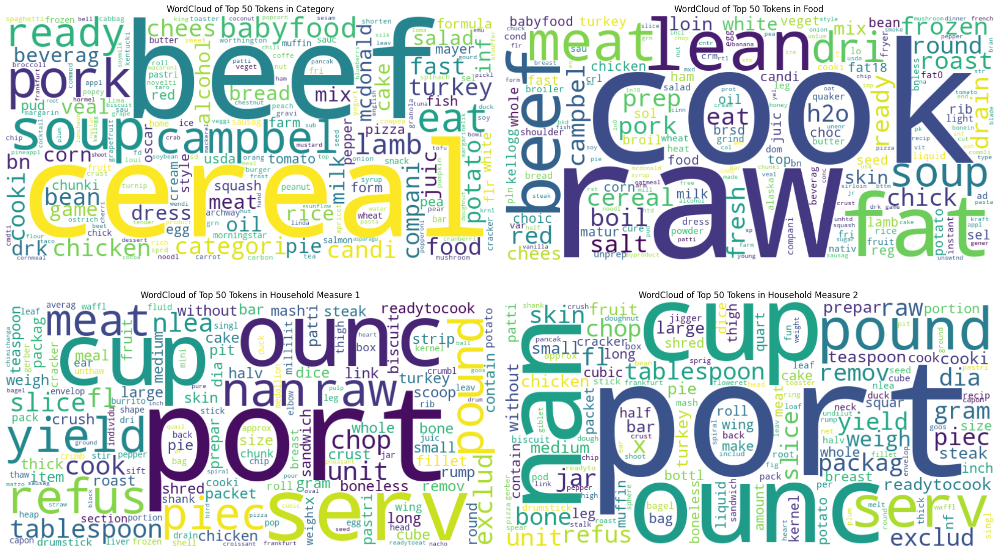

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# 📌 Βήμα 2: Ορισμός των στηλών για ανάλυση
columns_to_visualize = [ "Category","Food", "Household Measure 1", "Household Measure 2"]

plt.figure(figsize=(20, 12))

for i, column in enumerate(columns_to_visualize, 1):
    # Επιλογή των 50 πιο συχνών tokens από το προηγούμενο αποτέλεσμα
    top_tokens = top_real_unique_tokens_df[top_real_unique_tokens_df["Column"] == column]["Token"].tolist()

    # Δημιουργία κειμένου για το WordCloud
    tokens_text = ' '.join(top_tokens)

    # Δημιουργία του WordCloud
    wordcloud = WordCloud(width=800, height=400, background_color="white").generate(tokens_text)

    # Προβολή του WordCloud
    plt.subplot(2, 2, i)
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"WordCloud of Top 50 Tokens in {column}")

# 📌 Βήμα 4: Εμφάνιση των WordClouds
plt.tight_layout()
plt.show()


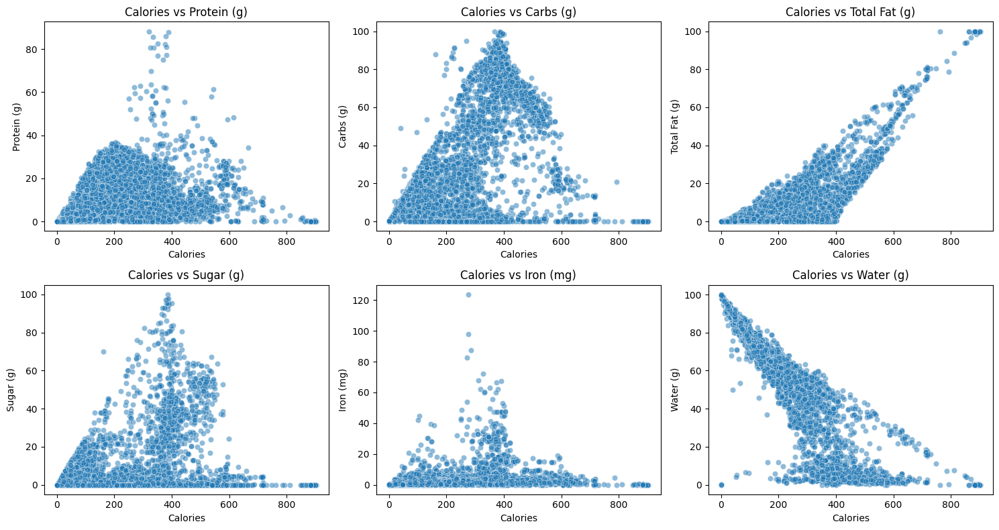

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns

macro_nutrients = ["Protein (g)", "Carbs (g)", "Total Fat (g)", "Sugar (g)", "Iron (mg)", "Water (g)"]

plt.figure(figsize=(15, 8))
for i, col in enumerate(macro_nutrients):
    plt.subplot(2, 3, i + 1)
    sns.scatterplot(x=df_nut_new_converted["Calories"], y=df_nut_new_converted[col], alpha=0.5)
    plt.xlabel("Calories")
    plt.ylabel(col)
    plt.title(f"Calories vs {col}")

plt.tight_layout()
plt.show()

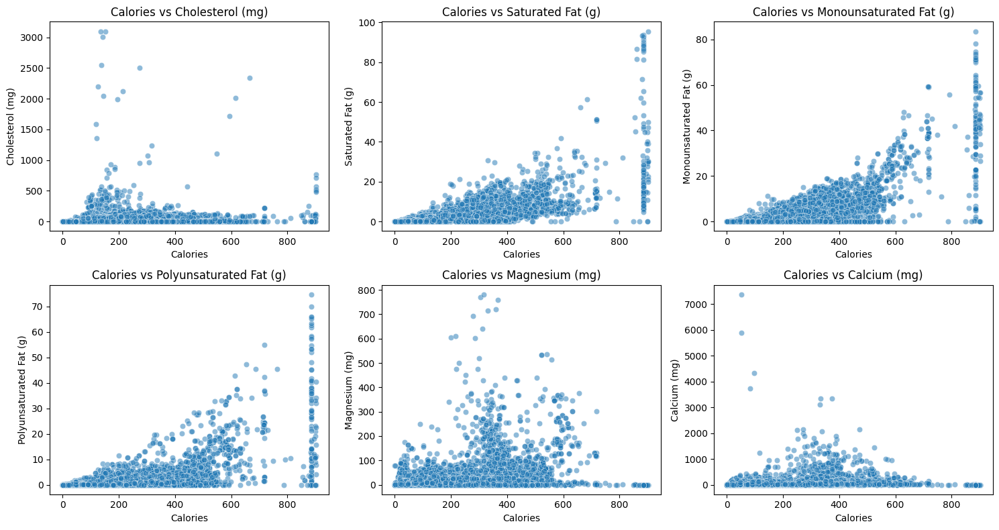

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns

macro_nutrients = ["Cholesterol (mg)", "Saturated Fat (g)", "Monounsaturated Fat (g)", "Polyunsaturated Fat (g)", "Magnesium (mg)", "Calcium (mg)"]

plt.figure(figsize=(15, 8))
for i, col in enumerate(macro_nutrients):
    plt.subplot(2, 3, i + 1)
    sns.scatterplot(x=df_nut_new_converted["Calories"], y=df_nut_new_converted[col], alpha=0.5)
    plt.xlabel("Calories")
    plt.ylabel(col)
    plt.title(f"Calories vs {col}")

plt.tight_layout()
plt.show()

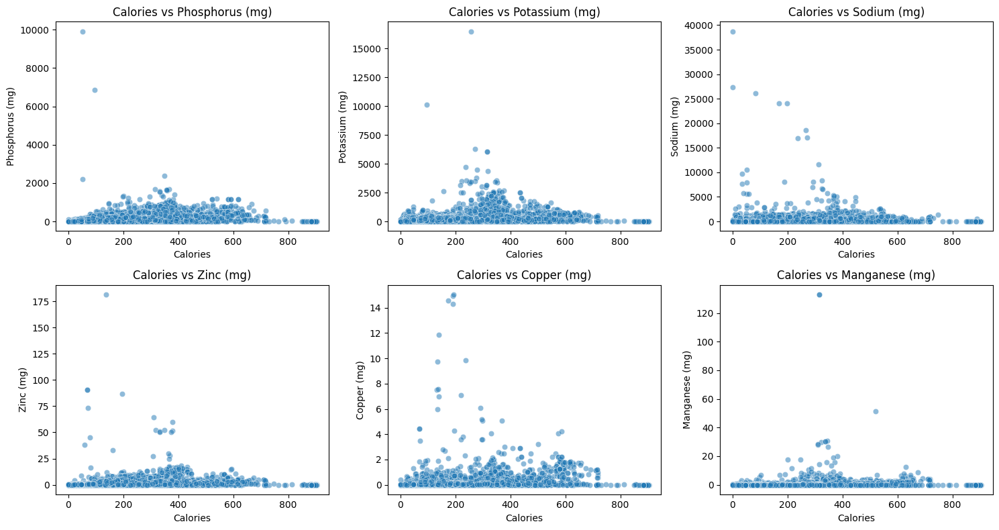

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns

macro_nutrients = ["Phosphorus (mg)", "Potassium (mg)", "Sodium (mg)", "Zinc (mg)", "Copper (mg)", "Manganese (mg)"]

plt.figure(figsize=(15, 8))
for i, col in enumerate(macro_nutrients):
    plt.subplot(2, 3, i + 1)
    sns.scatterplot(x=df_nut_new_converted["Calories"], y=df_nut_new_converted[col], alpha=0.5)
    plt.xlabel("Calories")
    plt.ylabel(col)
    plt.title(f"Calories vs {col}")

plt.tight_layout()
plt.show()

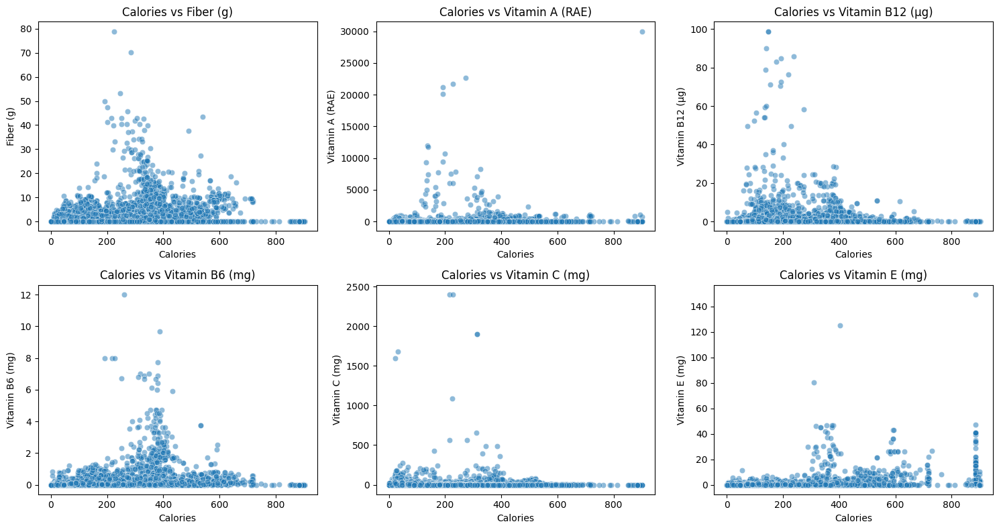

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns

macro_nutrients = ["Fiber (g)", "Vitamin A (RAE)", "Vitamin B12 (µg)", "Vitamin B6 (mg)", "Vitamin C (mg)", "Vitamin E (mg)"]

plt.figure(figsize=(15, 8))
for i, col in enumerate(macro_nutrients):
    plt.subplot(2, 3, i + 1)
    sns.scatterplot(x=df_nut_new_converted["Calories"], y=df_nut_new_converted[col], alpha=0.5)
    plt.xlabel("Calories")
    plt.ylabel(col)
    plt.title(f"Calories vs {col}")

plt.tight_layout()
plt.show()

In [ ]:
from sklearn.preprocessing import StandardScaler

nutrition_features = [
    "Calories", "Protein (g)", "Carbs (g)", "Sugar (g)", "Fiber (g)",
    "Total Fat (g)", "Cholesterol (mg)", "Water (g)", "Iron (mg)", "Vitamin A (RAE)",
    "Vitamin B12 (µg)", "Vitamin B6 (mg)", "Vitamin C (mg)", "Vitamin E (mg)","Saturated Fat (g)", "Monounsaturated Fat (g)", "Polyunsaturated Fat (g)", "Magnesium (mg)", "Calcium (mg)"
]

df_clustering = df_nut_new_converted[nutrition_features]

scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_clustering)

df_scaled = pd.DataFrame(df_scaled, columns=nutrition_features)

df_scaled.head()

,Calories,Protein (g),Carbs (g),Sugar (g),Fiber (g),Total Fat (g),Cholesterol (mg),Water (g),Iron (mg),Vitamin A (RAE),Vitamin B12 (µg),Vitamin B6 (mg),Vitamin C (mg),Vitamin E (mg),Saturated Fat (g),Monounsaturated Fat (g),Polyunsaturated Fat (g),Magnesium (mg),Calcium (mg)
0,2.897311,-0.950093,-0.801034,-0.453936,-0.464324,4.296811,1.485314,-1.271617,-0.451988,0.767544,-0.222249,-0.471700,-0.143061,0.354280,7.380499,2.372648,0.210650,-0.544771,-0.232881
1,2.897311,-0.950093,-0.801034,-0.453936,-0.464324,4.296811,1.518722,-1.271617,-0.429283,0.767544,-0.231114,-0.471700,-0.143061,0.354280,7.245667,2.703382,0.204649,-0.544771,-0.232881
2,3.823576,-1.004466,-0.803247,-0.458233,-0.464324,5.410267,1.827750,-1.777371,-0.455231,0.972376,-0.257706,-0.475239,-0.143061,0.469403,8.999713,3.433060,0.336669,-0.579404,-0.325760
3,0.776805,1.010212,-0.716969,-0.422423,-0.464324,1.122520,0.316020,-0.412838,-0.404956,0.129415,0.010437,-0.183244,-0.143061,-0.142185,2.364709,0.551480,-0.223544,-0.181124,2.107691
4,0.881665,1.185733,-0.700377,-0.421707,-0.464324,1.179496,0.474710,-0.454903,-0.385495,0.252839,0.019301,-0.361980,-0.143061,-0.139787,2.379281,0.664246,-0.226641,-0.163807,2.785714


In [ ]:
df_nut_new_converted[nutrition_features].std().sort_values()

Vitamin B6 (mg)              0.565116
Vitamin E (mg)               4.169756
Fiber (g)                    4.292873
Vitamin B12 (µg)             4.512816
Polyunsaturated Fat (g)      5.166244
Iron (mg)                    6.166548
Saturated Fat (g)            6.519652
Monounsaturated Fat (g)      7.272197
Protein (g)                 10.483772
Sugar (g)                   13.963748
Total Fat (g)               16.499285
Carbs (g)                   27.123491
Water (g)                   30.906416
Magnesium (mg)              57.752215
Vitamin C (mg)              63.443284
Cholesterol (mg)           119.738438
Calories                   171.668713
Calcium (mg)               215.346524
Vitamin A (RAE)            761.653061
dtype: float64

In [ ]:
from sklearn.ensemble import RandomForestRegressor

X = df_scaled[nutrition_features].drop(columns=["Calories"])  # Features
y = df_scaled["Calories"]  # Target variable (Calories)

model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X, y)

feature_importances = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=False)
print(feature_importances)

Water (g)                  0.747400
Total Fat (g)              0.238292
Carbs (g)                  0.003936
Protein (g)                0.002026
Fiber (g)                  0.001970
Saturated Fat (g)          0.001367
Calcium (mg)               0.001217
Monounsaturated Fat (g)    0.000705
Magnesium (mg)             0.000614
Vitamin C (mg)             0.000537
Iron (mg)                  0.000460
Vitamin B6 (mg)            0.000360
Polyunsaturated Fat (g)    0.000308
Sugar (g)                  0.000238
Cholesterol (mg)           0.000155
Vitamin B12 (µg)           0.000144
Vitamin E (mg)             0.000140
Vitamin A (RAE)            0.000131
dtype: float64


In [ ]:
# Macronutrients
# ✔ Calories (kcal ή kJ)
# ✔ Total Fat (g)
# ✔ Saturated Fat (g)
# ✔ Monounsaturated Fat (g)
# ✔ Carbohydrates (g)
# ✔ Sugar (g)
# ✔ Fiber (g)
# ✔ Protein (g)

In [ ]:
df_nut_new_converted.columns

Index(['Category', 'Food', 'Calories', 'Protein (g)', 'Carbs (g)', 'Fiber (g)',
       'Sugar (g)', 'Total Fat (g)', 'Saturated Fat (g)',
       'Monounsaturated Fat (g)', 'Polyunsaturated Fat (g)',
       'Cholesterol (mg)', 'Water (g)', 'Vitamin A (RAE)', 'Vitamin B12 (µg)',
       'Vitamin B6 (mg)', 'Vitamin C (mg)', 'Vitamin E (mg)', 'Vitamin K (µg)',
       'Calcium (mg)', 'Iron (mg)', 'Magnesium (mg)', 'Phosphorus (mg)',
       'Potassium (mg)', 'Sodium (mg)', 'Zinc (mg)', 'Copper (mg)',
       'Selenium (µg)', 'Manganese (mg)', 'Household Weight 1 (g)',
       'Household Measure 1', 'Household Weight 2 (g)', 'Household Measure 2'],
      dtype='object')

In [ ]:
final_features = ["Category", "Food","Calories",
    "Total Fat (g)","Saturated Fat (g)", "Monounsaturated Fat (g)",
    "Carbs (g)", "Sugar (g)", "Fiber (g)", "Protein (g)",
    "Household Weight 1 (g)","Household Measure 1",
    "Household Weight 2 (g)", "Household Measure 2",
                 ]

df_final = df_nut_new_converted[final_features]

In [ ]:
path = r"C:\Users\User\Desktop\NLP PROJECT RECIPES\df_final.csv"
df_final.to_csv(path, index=False, encoding='utf-8')



In [ ]:
all_tokens = [token for sublist in df_final["Category"] for token in sublist]
token_counts = Counter(all_tokens)
most_common_tokens = token_counts.most_common(20)
df_common_tokens = pd.DataFrame(most_common_tokens, columns=["Token", "Frequency"])
df_common_tokens



,Token,Frequency
0,beef,511
1,cereal,429
2,soup,400
3,pork,313
4,campbel,310
5,ready to eat,292
6,babyfood,222
7,lamb,199
8,categori,198
9,chicken,171


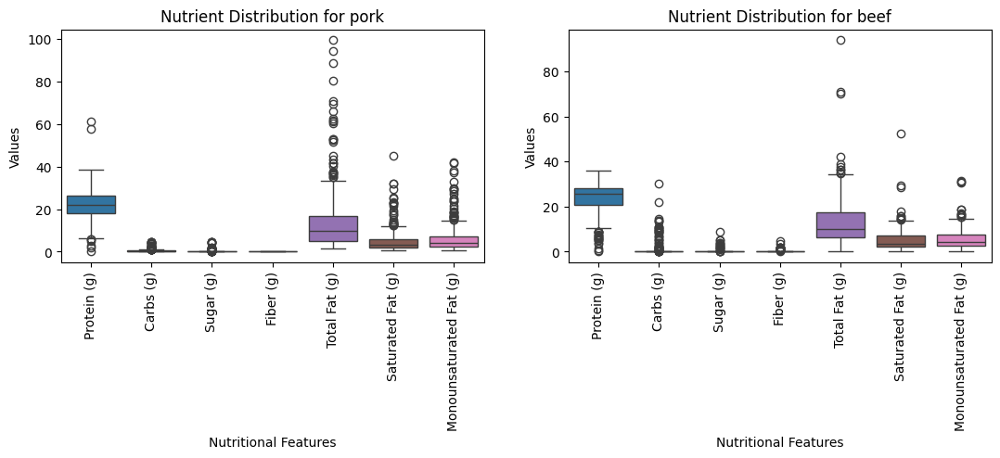

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

selected_tokens = ["pork", "beef"]

nutrition_features = [
   "Protein (g)", "Carbs (g)",  "Sugar (g)","Fiber (g)","Total Fat (g)", "Saturated Fat (g)", "Monounsaturated Fat (g)"]

plt.figure(figsize=(20, 15))

valid_categories = 0

for i, category in enumerate(selected_tokens, 1):
    category_df = df_final[df_final["Category"].apply(lambda tokens: category in tokens)]

    if not category_df.empty:
        valid_categories += 1
        plt.subplot(4, 3, valid_categories)
        sns.boxplot(data=category_df[nutrition_features])

        # Labels and Titles
        plt.xlabel("Nutritional Features")
        plt.ylabel("Values")
        plt.xticks(rotation=90)
        plt.title(f"Nutrient Distribution for {category}")



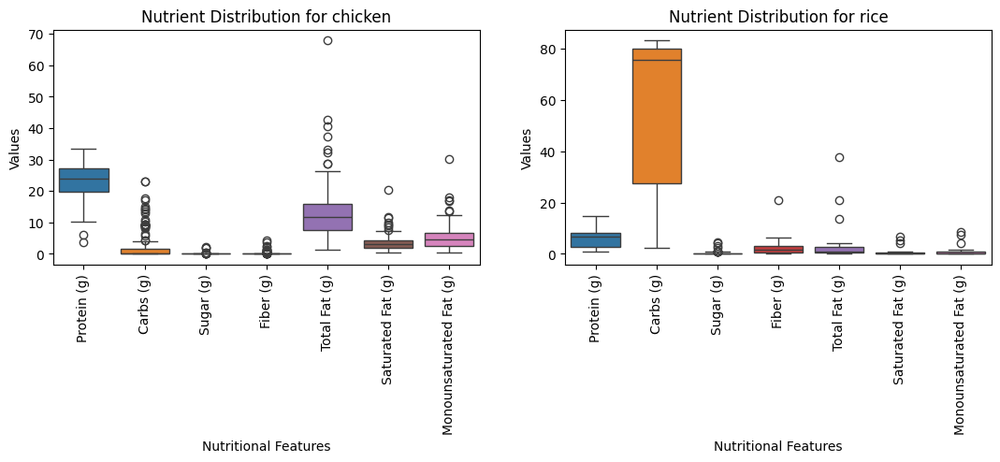

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

selected_tokens = ["chicken", "rice"]

nutrition_features = [
   "Protein (g)", "Carbs (g)",  "Sugar (g)","Fiber (g)","Total Fat (g)", "Saturated Fat (g)", "Monounsaturated Fat (g)"]

plt.figure(figsize=(20, 15))

valid_categories = 0

for i, category in enumerate(selected_tokens, 1):
    category_df = df_final[df_final["Category"].apply(lambda tokens: category in tokens)]

    if not category_df.empty:
        valid_categories += 1
        plt.subplot(4, 3, valid_categories)
        sns.boxplot(data=category_df[nutrition_features])

        # Labels and Titles
        plt.xlabel("Nutritional Features")
        plt.ylabel("Values")
        plt.xticks(rotation=90)
        plt.title(f"Nutrient Distribution for {category}")



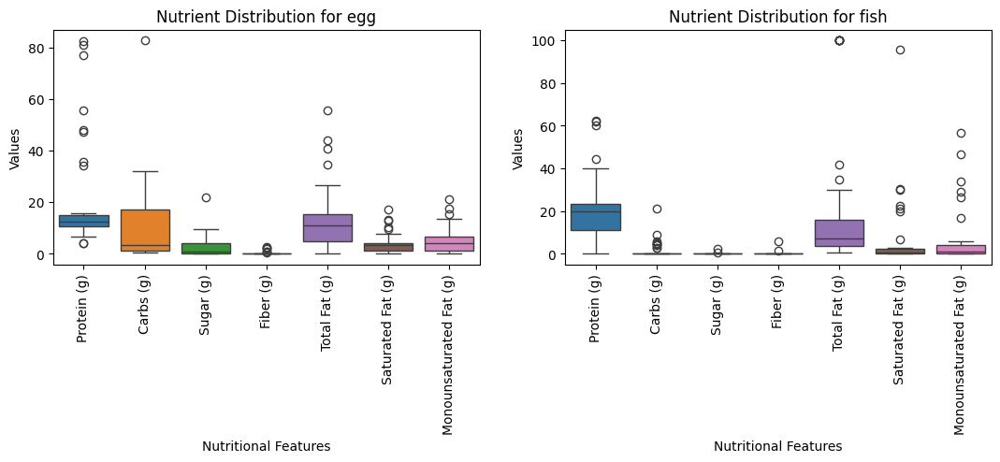

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

selected_tokens = ["egg", "fish"]

nutrition_features = [
   "Protein (g)", "Carbs (g)",  "Sugar (g)","Fiber (g)","Total Fat (g)", "Saturated Fat (g)", "Monounsaturated Fat (g)"]

plt.figure(figsize=(20, 15))

valid_categories = 0

for i, category in enumerate(selected_tokens, 1):
    category_df = df_final[df_final["Category"].apply(lambda tokens: category in tokens)]

    if not category_df.empty:
        valid_categories += 1
        plt.subplot(4, 3, valid_categories)
        sns.boxplot(data=category_df[nutrition_features])

        # Labels and Titles
        plt.xlabel("Nutritional Features")
        plt.ylabel("Values")
        plt.xticks(rotation=90)
        plt.title(f"Nutrient Distribution for {category}")



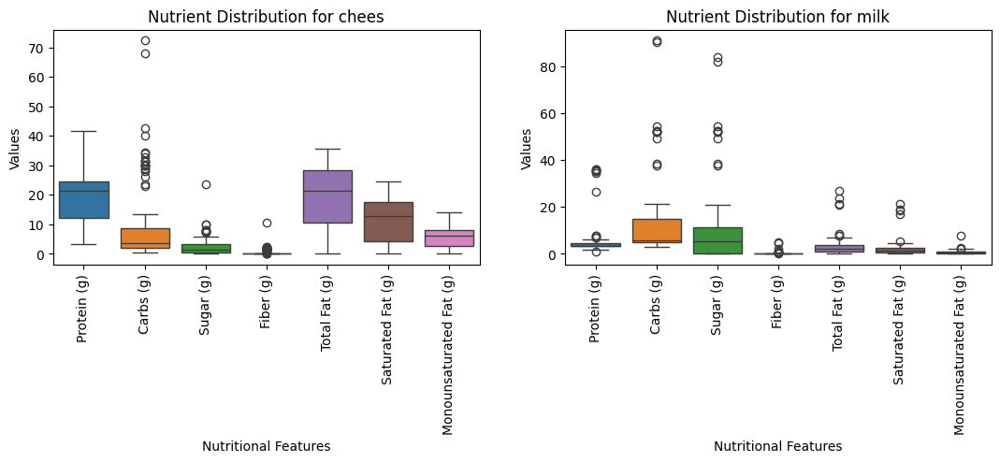

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

selected_tokens = ["chees", "milk"]

nutrition_features = [
   "Protein (g)", "Carbs (g)",  "Sugar (g)","Fiber (g)","Total Fat (g)", "Saturated Fat (g)", "Monounsaturated Fat (g)"]

plt.figure(figsize=(20, 15))

valid_categories = 0

for i, category in enumerate(selected_tokens, 1):
    category_df = df_final[df_final["Category"].apply(lambda tokens: category in tokens)]

    if not category_df.empty:
        valid_categories += 1
        plt.subplot(4, 3, valid_categories)
        sns.boxplot(data=category_df[nutrition_features])

        # Labels and Titles
        plt.xlabel("Nutritional Features")
        plt.ylabel("Values")
        plt.xticks(rotation=90)
        plt.title(f"Nutrient Distribution for {category}")



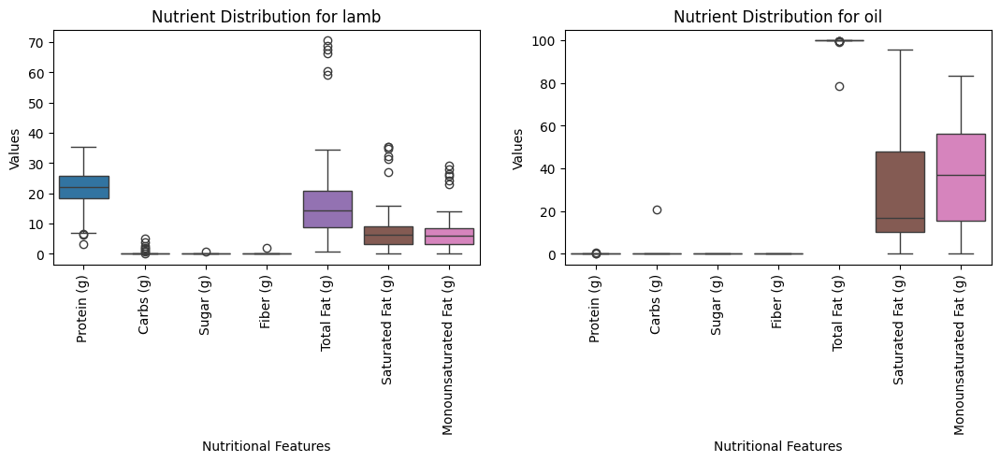

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

selected_tokens = ["lamb", "oil"]

nutrition_features = [
   "Protein (g)", "Carbs (g)",  "Sugar (g)","Fiber (g)","Total Fat (g)", "Saturated Fat (g)", "Monounsaturated Fat (g)"]

plt.figure(figsize=(20, 15))

valid_categories = 0

for i, category in enumerate(selected_tokens, 1):
    category_df = df_final[df_final["Category"].apply(lambda tokens: category in tokens)]

    if not category_df.empty:
        valid_categories += 1
        plt.subplot(4, 3, valid_categories)
        sns.boxplot(data=category_df[nutrition_features])

        # Labels and Titles
        plt.xlabel("Nutritional Features")
        plt.ylabel("Values")
        plt.xticks(rotation=90)
        plt.title(f"Nutrient Distribution for {category}")



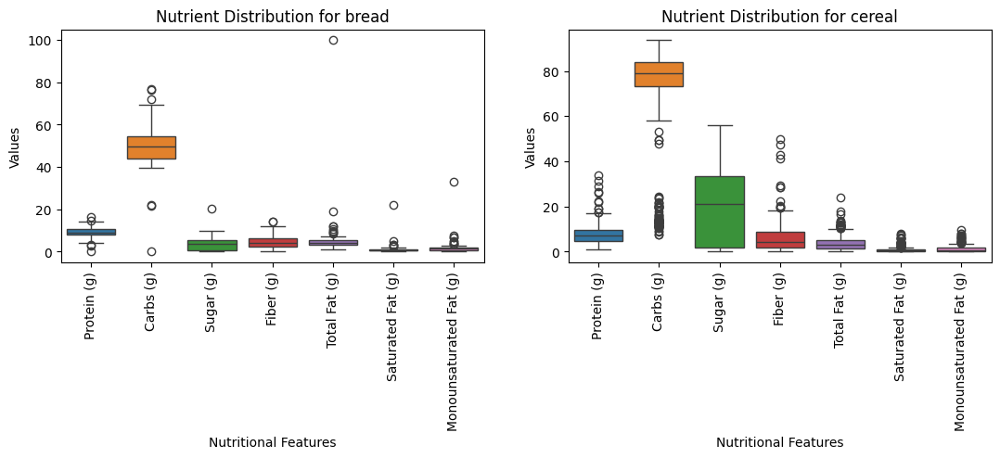

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

selected_tokens = ["bread", "cereal"]

nutrition_features = [
   "Protein (g)", "Carbs (g)",  "Sugar (g)","Fiber (g)","Total Fat (g)", "Saturated Fat (g)", "Monounsaturated Fat (g)"]

plt.figure(figsize=(20, 15))

valid_categories = 0

for i, category in enumerate(selected_tokens, 1):
    category_df = df_final[df_final["Category"].apply(lambda tokens: category in tokens)]

    if not category_df.empty:
        valid_categories += 1
        plt.subplot(4, 3, valid_categories)
        sns.boxplot(data=category_df[nutrition_features])

        # Labels and Titles
        plt.xlabel("Nutritional Features")
        plt.ylabel("Values")
        plt.xticks(rotation=90)
        plt.title(f"Nutrient Distribution for {category}")


C:\Users\User\AppData\Local\Temp\ipykernel_38208\1397333845.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df["Matched Token"] = filtered_df["Category"].apply(


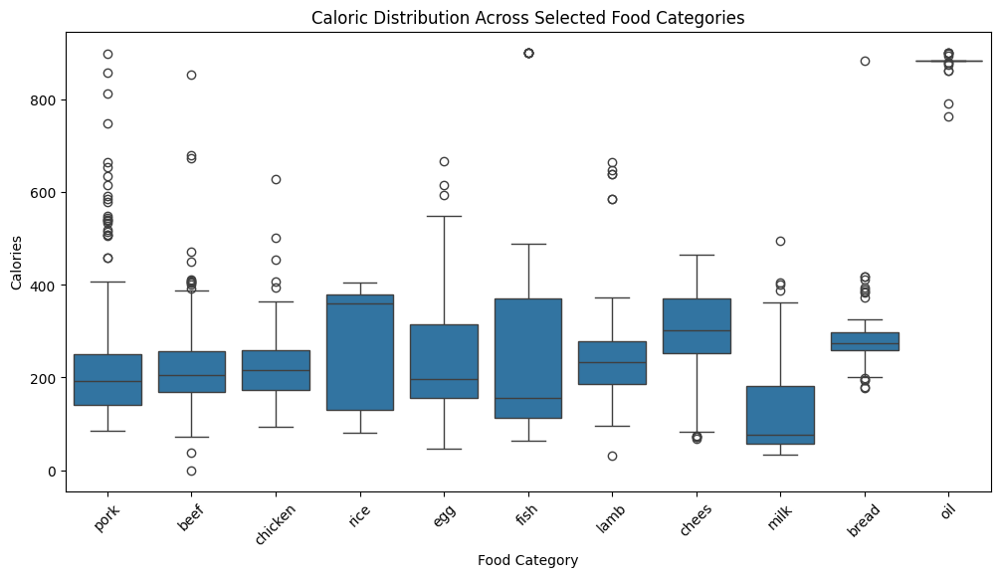

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns


selected_tokens = ["pork", "beef", "chicken", "rice", "egg", "fish", "lamb", "chees", "milk", "bread","oil"]

filtered_df = df_final[df_final["Category"].apply(lambda tokens: any(token in tokens for token in selected_tokens))]

filtered_df["Matched Token"] = filtered_df["Category"].apply(
    lambda tokens: next((token for token in selected_tokens if token in tokens), None)
)

plt.figure(figsize=(12, 6))
sns.boxplot(data=filtered_df, x="Matched Token", y="Calories", order=selected_tokens)

plt.xticks(rotation=45)
plt.xlabel("Food Category")
plt.ylabel("Calories")
plt.title("Caloric Distribution Across Selected Food Categories")

plt.show()


In [ ]:
df_final.head(50)

,Category,Food,Calories,Total Fat (g),Saturated Fat (g),Monounsaturated Fat (g),Carbs (g),Sugar (g),Fiber (g),Protein (g),Household Weight 1 (g),Household Measure 1,Household Weight 2 (g),Household Measure 2
0,[butter],"[butter, salt]",717.0,81.11,51.368,21.021,0.06,0.06,0.0,0.85,227.00,"[1, cup]",14.0,"[1, tablespoon]"
1,[butter],"[butter, whip, salt]",717.0,81.11,50.489,23.426,0.06,0.06,0.0,0.85,151.00,"[1, cup]",9.0,"[1, tablespoon]"
2,"[butter, oil]","[butter, oil, anhydr]",876.0,99.48,61.924,28.732,0.00,0.00,0.0,0.28,205.00,"[1, cup]",13.0,"[1, tablespoon]"
3,[chees],"[chees, blue]",353.0,28.74,18.669,7.778,2.34,0.50,0.0,21.40,28.35,"[1, ounc]",17.0,"[1, cubic, inch]"
4,[chees],"[chees, brick]",371.0,29.68,18.764,8.598,2.79,0.51,0.0,23.24,132.00,"[1, cup, dice]",113.0,"[1, cup, shred]"
5,[chees],"[chees, brie]",334.0,27.68,17.410,8.013,0.45,0.45,0.0,20.75,240.00,"[1, cup, melt]",144.0,"[1, cup, slice]"
6,[chees],"[chees, camembert]",300.0,24.26,15.259,7.023,0.46,0.46,0.0,19.80,246.00,"[1, cup]",28.0,"[1, ounc]"
7,[chees],"[chees, caraway]",376.0,29.20,18.584,8.275,3.06,0.00,0.0,25.18,28.35,"[1, ounc]",0.0,[nan]
8,[chees],"[chees, cheddar]",403.0,33.14,21.092,9.391,1.28,0.52,0.0,24.90,132.00,"[1, cup, dice]",244.0,"[1, cup, melt]"
9,[chees],"[chees, cheshir]",387.0,30.60,19.475,8.671,4.78,0.00,0.0,23.37,28.35,"[1, ounc]",0.0,[nan]


In [ ]:
import numpy as np
from scipy.stats import zscore

def detect_outliers(df, columns, threshold=3):
    outliers = {}
    for col in columns:
        if df[col].dtype in ['int64', 'float64']:
            z_scores = np.abs(zscore(df[col]))
            outliers[col] = np.where(z_scores > threshold)[0]
        else:
            print(f"Skipping non-numeric column: {col}")
    return outliers

outliers_dict = detect_outliers(df_final, final_features)

for key, value in outliers_dict.items():
    print(f"{key}: {len(value)} outliers detected")


Skipping non-numeric column: Category
Skipping non-numeric column: Food
Skipping non-numeric column: Household Measure 1
Skipping non-numeric column: Household Measure 2
Calories: 119 outliers detected
Total Fat (g): 194 outliers detected
Saturated Fat (g): 100 outliers detected
Monounsaturated Fat (g): 164 outliers detected
Carbs (g): 0 outliers detected
Sugar (g): 229 outliers detected
Fiber (g): 137 outliers detected
Protein (g): 49 outliers detected
Household Weight 1 (g): 66 outliers detected
Household Weight 2 (g): 108 outliers detected


In [ ]:
outlier_rows = set()
for col, indices in outliers_dict.items():
    outlier_rows.update(indices)

df_outliers = df_final.loc[list(outlier_rows)]

df_outliers


,Category,Food,Calories,Total Fat (g),Saturated Fat (g),Monounsaturated Fat (g),Carbs (g),Sugar (g),Fiber (g),Protein (g),Household Weight 1 (g),Household Measure 1,Household Weight 2 (g),Household Measure 2
0,[butter],"[butter, salt]",717.0,81.11,51.368,21.021,0.06,0.060000,0.000000,0.85,227.00,"[1, cup]",14.0,"[1, tablespoon]"
1,[butter],"[butter, whip, salt]",717.0,81.11,50.489,23.426,0.06,0.060000,0.000000,0.85,151.00,"[1, cup]",9.0,"[1, tablespoon]"
2,"[butter, oil]","[butter, oil, anhydr]",876.0,99.48,61.924,28.732,0.00,0.000000,0.000000,0.28,205.00,"[1, cup]",13.0,"[1, tablespoon]"
4097,"[drink, mix]","[drink, mix, quaker, oat, gatorad, lemonlim, f...",364.0,0.00,0.000,0.000,95.30,89.699997,0.000000,0.00,16.00,"[75, scoop]",0.0,[nan]
6162,"[rice, bran]","[rice, bran, crude]",316.0,20.85,4.171,7.549,49.69,0.900000,21.000000,13.35,118.00,"[1, cup]",0.0,[nan]
6165,"[rye, flour]","[rye, flour, dark]",324.0,2.69,0.309,0.326,68.74,1.040000,22.600000,14.03,128.00,"[1, cup]",0.0,[nan]
2076,"[cereal, ready to eat]","[cereal, ready to eat, uncl, sam, crl]",431.0,11.60,1.320,1.980,65.78,1.560000,20.299999,15.98,55.00,"[1, cup, 1, serv]",0.0,[nan]
4126,"[chocolateflavor, beverag, mix, milk]","[chocolateflavor, beverag, mix, milk, powder, ...",405.0,3.10,1.834,1.009,90.90,83.879997,4.800000,3.30,21.60,"[1, portion, 23, heap, teaspoon]",0.0,[nan]
4128,[categori],"[chocol, syrup]",279.0,1.13,0.519,0.286,65.10,49.650002,2.600000,2.10,38.50,"[1, serv, 2, tablespoon]",300.0,"[1, cup]"
4131,"[cocoa, mix]","[cocoa, mix, powder]",398.0,4.00,2.377,1.325,83.73,65.550003,3.700000,6.67,28.35,"[1, serv, 3, heap, teaspoon, 1, envelop]",0.0,[nan]
